# Session (475165_f3_stage2_day5)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f3_stage2_day5" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f3"
day = "day5"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35161, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


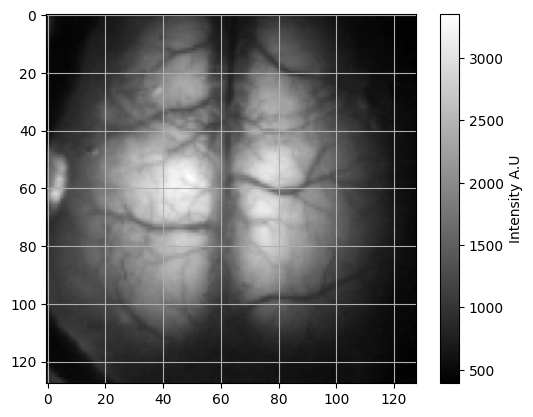

frame number 6000 plotted


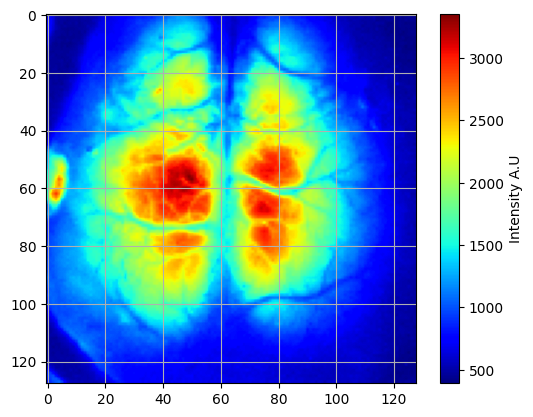

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 442.1484375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 497.4169921875


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 88
Number of double_flash pairs: 44
Number of single_flash: 37
Number of total flashes: 125


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/125 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/125 [00:01<02:44,  1.33s/it]

  2%|█▎                                                                                | 2/125 [00:02<02:38,  1.29s/it]

  2%|█▉                                                                                | 3/125 [00:03<02:38,  1.30s/it]

  3%|██▌                                                                               | 4/125 [00:05<02:38,  1.31s/it]

  4%|███▎                                                                              | 5/125 [00:06<02:32,  1.27s/it]

  5%|███▉                                                                              | 6/125 [00:07<02:30,  1.26s/it]

  6%|████▌                                                                             | 7/125 [00:09<02:31,  1.29s/it]

  6%|█████▏                                                                            | 8/125 [00:10<02:32,  1.30s/it]

  7%|█████▉                                                                            | 9/125 [00:11<02:30,  1.30s/it]

  8%|██████▍                                                                          | 10/125 [00:12<02:30,  1.31s/it]

  9%|███████▏                                                                         | 11/125 [00:14<02:26,  1.28s/it]

 10%|███████▊                                                                         | 12/125 [00:15<02:24,  1.28s/it]

 10%|████████▍                                                                        | 13/125 [00:16<02:21,  1.26s/it]

 11%|█████████                                                                        | 14/125 [00:18<02:22,  1.29s/it]

 12%|█████████▋                                                                       | 15/125 [00:19<02:24,  1.31s/it]

 13%|██████████▎                                                                      | 16/125 [00:20<02:27,  1.35s/it]

 14%|███████████                                                                      | 17/125 [00:22<02:24,  1.33s/it]

 14%|███████████▋                                                                     | 18/125 [00:23<02:24,  1.35s/it]

 15%|████████████▎                                                                    | 19/125 [00:24<02:25,  1.37s/it]

 16%|████████████▉                                                                    | 20/125 [00:26<02:23,  1.36s/it]

 17%|█████████████▌                                                                   | 21/125 [00:27<02:24,  1.39s/it]

 18%|██████████████▎                                                                  | 22/125 [00:29<02:20,  1.36s/it]

 18%|██████████████▉                                                                  | 23/125 [00:30<02:21,  1.39s/it]

 19%|███████████████▌                                                                 | 24/125 [00:31<02:19,  1.38s/it]

 20%|████████████████▏                                                                | 25/125 [00:33<02:13,  1.33s/it]

 21%|████████████████▊                                                                | 26/125 [00:34<02:06,  1.28s/it]

 22%|█████████████████▍                                                               | 27/125 [00:35<02:01,  1.24s/it]

 22%|██████████████████▏                                                              | 28/125 [00:36<01:59,  1.24s/it]

 23%|██████████████████▊                                                              | 29/125 [00:37<01:57,  1.22s/it]

 24%|███████████████████▍                                                             | 30/125 [00:39<01:58,  1.25s/it]

 25%|████████████████████                                                             | 31/125 [00:40<01:59,  1.27s/it]

 26%|████████████████████▋                                                            | 32/125 [00:41<01:58,  1.27s/it]

 26%|█████████████████████▍                                                           | 33/125 [00:42<01:57,  1.27s/it]

 27%|██████████████████████                                                           | 34/125 [00:44<01:55,  1.27s/it]

 28%|██████████████████████▋                                                          | 35/125 [00:45<01:56,  1.29s/it]

 29%|███████████████████████▎                                                         | 36/125 [00:46<01:53,  1.28s/it]

 30%|███████████████████████▉                                                         | 37/125 [00:48<01:53,  1.29s/it]

 30%|████████████████████████▌                                                        | 38/125 [00:49<01:56,  1.33s/it]

 31%|█████████████████████████▎                                                       | 39/125 [00:50<01:53,  1.32s/it]

 32%|█████████████████████████▉                                                       | 40/125 [00:52<01:50,  1.30s/it]

 33%|██████████████████████████▌                                                      | 41/125 [00:53<01:48,  1.29s/it]

 34%|███████████████████████████▏                                                     | 42/125 [00:54<01:46,  1.29s/it]

 34%|███████████████████████████▊                                                     | 43/125 [00:56<01:46,  1.30s/it]

 35%|████████████████████████████▌                                                    | 44/125 [00:57<01:46,  1.31s/it]

 36%|█████████████████████████████▏                                                   | 45/125 [00:58<01:40,  1.26s/it]

 37%|█████████████████████████████▊                                                   | 46/125 [00:59<01:38,  1.24s/it]

 38%|██████████████████████████████▍                                                  | 47/125 [01:01<01:38,  1.27s/it]

 38%|███████████████████████████████                                                  | 48/125 [01:02<01:37,  1.27s/it]

 39%|███████████████████████████████▊                                                 | 49/125 [01:03<01:38,  1.30s/it]

 40%|████████████████████████████████▍                                                | 50/125 [01:05<01:40,  1.34s/it]

 41%|█████████████████████████████████                                                | 51/125 [01:06<01:37,  1.31s/it]

 42%|█████████████████████████████████▋                                               | 52/125 [01:07<01:39,  1.36s/it]

 42%|██████████████████████████████████▎                                              | 53/125 [01:09<01:36,  1.34s/it]

 43%|██████████████████████████████████▉                                              | 54/125 [01:10<01:36,  1.36s/it]

 44%|███████████████████████████████████▋                                             | 55/125 [01:11<01:35,  1.36s/it]

 45%|████████████████████████████████████▎                                            | 56/125 [01:13<01:34,  1.37s/it]

 46%|████████████████████████████████████▉                                            | 57/125 [01:14<01:33,  1.37s/it]

 46%|█████████████████████████████████████▌                                           | 58/125 [01:15<01:29,  1.33s/it]

 47%|██████████████████████████████████████▏                                          | 59/125 [01:17<01:27,  1.33s/it]

 48%|██████████████████████████████████████▉                                          | 60/125 [01:18<01:25,  1.32s/it]

 49%|███████████████████████████████████████▌                                         | 61/125 [01:19<01:22,  1.29s/it]

 50%|████████████████████████████████████████▏                                        | 62/125 [01:20<01:20,  1.29s/it]

 50%|████████████████████████████████████████▊                                        | 63/125 [01:22<01:19,  1.28s/it]

 51%|█████████████████████████████████████████▍                                       | 64/125 [01:23<01:16,  1.26s/it]

 52%|██████████████████████████████████████████                                       | 65/125 [01:24<01:15,  1.26s/it]

 53%|██████████████████████████████████████████▊                                      | 66/125 [01:26<01:16,  1.29s/it]

 54%|███████████████████████████████████████████▍                                     | 67/125 [01:27<01:14,  1.28s/it]

 54%|████████████████████████████████████████████                                     | 68/125 [01:28<01:11,  1.26s/it]

 55%|████████████████████████████████████████████▋                                    | 69/125 [01:29<01:11,  1.29s/it]

 56%|█████████████████████████████████████████████▎                                   | 70/125 [01:31<01:11,  1.30s/it]

 57%|██████████████████████████████████████████████                                   | 71/125 [01:32<01:11,  1.32s/it]

 58%|██████████████████████████████████████████████▋                                  | 72/125 [01:34<01:11,  1.34s/it]

 58%|███████████████████████████████████████████████▎                                 | 73/125 [01:35<01:09,  1.33s/it]

 59%|███████████████████████████████████████████████▉                                 | 74/125 [01:36<01:06,  1.31s/it]

 60%|████████████████████████████████████████████████▌                                | 75/125 [01:37<01:06,  1.33s/it]

 61%|█████████████████████████████████████████████████▏                               | 76/125 [01:39<01:05,  1.33s/it]

 62%|█████████████████████████████████████████████████▉                               | 77/125 [01:40<01:05,  1.36s/it]

 62%|██████████████████████████████████████████████████▌                              | 78/125 [01:41<01:02,  1.33s/it]

 63%|███████████████████████████████████████████████████▏                             | 79/125 [01:43<01:01,  1.33s/it]

 64%|███████████████████████████████████████████████████▊                             | 80/125 [01:44<01:00,  1.34s/it]

 65%|████████████████████████████████████████████████████▍                            | 81/125 [01:46<00:59,  1.35s/it]

 66%|█████████████████████████████████████████████████████▏                           | 82/125 [01:47<00:58,  1.36s/it]

 66%|█████████████████████████████████████████████████████▊                           | 83/125 [01:48<00:56,  1.34s/it]

 67%|██████████████████████████████████████████████████████▍                          | 84/125 [01:49<00:53,  1.32s/it]

 68%|███████████████████████████████████████████████████████                          | 85/125 [01:51<00:52,  1.31s/it]

 69%|███████████████████████████████████████████████████████▋                         | 86/125 [01:52<00:51,  1.31s/it]

 70%|████████████████████████████████████████████████████████▍                        | 87/125 [01:53<00:49,  1.30s/it]

 70%|█████████████████████████████████████████████████████████                        | 88/125 [01:55<00:48,  1.30s/it]

 71%|█████████████████████████████████████████████████████████▋                       | 89/125 [01:56<00:45,  1.28s/it]

 72%|██████████████████████████████████████████████████████████▎                      | 90/125 [01:57<00:45,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▉                      | 91/125 [01:59<00:43,  1.29s/it]

 74%|███████████████████████████████████████████████████████████▌                     | 92/125 [02:00<00:42,  1.30s/it]

 74%|████████████████████████████████████████████████████████████▎                    | 93/125 [02:01<00:42,  1.33s/it]

 75%|████████████████████████████████████████████████████████████▉                    | 94/125 [02:03<00:41,  1.32s/it]

 76%|█████████████████████████████████████████████████████████████▌                   | 95/125 [02:04<00:41,  1.37s/it]

 77%|██████████████████████████████████████████████████████████████▏                  | 96/125 [02:05<00:39,  1.37s/it]

 78%|██████████████████████████████████████████████████████████████▊                  | 97/125 [02:07<00:37,  1.32s/it]

 78%|███████████████████████████████████████████████████████████████▌                 | 98/125 [02:08<00:34,  1.27s/it]

 79%|████████████████████████████████████████████████████████████████▏                | 99/125 [02:09<00:33,  1.30s/it]

 80%|████████████████████████████████████████████████████████████████                | 100/125 [02:10<00:32,  1.29s/it]

 81%|████████████████████████████████████████████████████████████████▋               | 101/125 [02:12<00:30,  1.28s/it]

 82%|█████████████████████████████████████████████████████████████████▎              | 102/125 [02:13<00:29,  1.28s/it]

 82%|█████████████████████████████████████████████████████████████████▉              | 103/125 [02:14<00:28,  1.31s/it]

 83%|██████████████████████████████████████████████████████████████████▌             | 104/125 [02:16<00:27,  1.29s/it]

 84%|███████████████████████████████████████████████████████████████████▏            | 105/125 [02:17<00:25,  1.25s/it]

 85%|███████████████████████████████████████████████████████████████████▊            | 106/125 [02:18<00:24,  1.28s/it]

 86%|████████████████████████████████████████████████████████████████████▍           | 107/125 [02:19<00:22,  1.25s/it]

 86%|█████████████████████████████████████████████████████████████████████           | 108/125 [02:21<00:22,  1.33s/it]

 87%|█████████████████████████████████████████████████████████████████████▊          | 109/125 [02:22<00:21,  1.36s/it]

 88%|██████████████████████████████████████████████████████████████████████▍         | 110/125 [02:24<00:20,  1.35s/it]

 89%|███████████████████████████████████████████████████████████████████████         | 111/125 [02:25<00:18,  1.35s/it]

 90%|███████████████████████████████████████████████████████████████████████▋        | 112/125 [02:26<00:17,  1.36s/it]

 90%|████████████████████████████████████████████████████████████████████████▎       | 113/125 [02:28<00:15,  1.33s/it]

 91%|████████████████████████████████████████████████████████████████████████▉       | 114/125 [02:29<00:14,  1.32s/it]

 92%|█████████████████████████████████████████████████████████████████████████▌      | 115/125 [02:30<00:12,  1.30s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 116/125 [02:31<00:11,  1.29s/it]

 94%|██████████████████████████████████████████████████████████████████████████▉     | 117/125 [02:33<00:10,  1.33s/it]

 94%|███████████████████████████████████████████████████████████████████████████▌    | 118/125 [02:34<00:09,  1.30s/it]

 95%|████████████████████████████████████████████████████████████████████████████▏   | 119/125 [02:35<00:07,  1.26s/it]

 96%|████████████████████████████████████████████████████████████████████████████▊   | 120/125 [02:36<00:06,  1.29s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 121/125 [02:38<00:05,  1.30s/it]

 98%|██████████████████████████████████████████████████████████████████████████████  | 122/125 [02:39<00:03,  1.29s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 123/125 [02:40<00:02,  1.31s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 124/125 [02:42<00:01,  1.28s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 125/125 [02:43<00:00,  1.30s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 125/125 [02:43<00:00,  1.31s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▊                                                             | 30/128 [00:00<00:00, 297.13it/s]

 47%|█████████████████████████████████████▌                                          | 60/128 [00:00<00:00, 293.71it/s]

 70%|████████████████████████████████████████████████████████▎                       | 90/128 [00:00<00:00, 243.78it/s]

 93%|█████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:00<00:00, 257.15it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 247.66it/s]

  0%|                                                                                        | 0/34297 [00:00<?, ?it/s]

  0%|                                                                              | 28/34297 [00:00<02:03, 277.32it/s]

  0%|▏                                                                             | 56/34297 [00:00<02:05, 272.56it/s]

  0%|▏                                                                             | 84/34297 [00:00<02:30, 227.79it/s]

  0%|▎                                                                            | 115/34297 [00:00<02:14, 253.68it/s]

  0%|▎                                                                            | 146/34297 [00:00<02:06, 270.46it/s]

  1%|▍                                                                            | 177/34297 [00:00<02:01, 280.40it/s]

  1%|▍                                                                            | 207/34297 [00:00<01:59, 285.77it/s]

  1%|▌                                                                            | 236/34297 [00:00<02:09, 262.17it/s]

  1%|▌                                                                            | 263/34297 [00:01<02:16, 249.64it/s]

  1%|▋                                                                            | 292/34297 [00:01<02:11, 259.04it/s]

  1%|▋                                                                            | 322/34297 [00:01<02:06, 269.14it/s]

  1%|▊                                                                            | 350/34297 [00:01<02:09, 261.71it/s]

  1%|▊                                                                            | 378/34297 [00:01<02:07, 266.33it/s]

  1%|▉                                                                            | 407/34297 [00:01<02:05, 270.82it/s]

  1%|▉                                                                            | 436/34297 [00:01<02:04, 272.46it/s]

  1%|█                                                                            | 464/34297 [00:01<02:08, 262.51it/s]

  1%|█                                                                            | 491/34297 [00:01<02:08, 263.17it/s]

  2%|█▏                                                                           | 519/34297 [00:01<02:06, 266.49it/s]

  2%|█▏                                                                           | 547/34297 [00:02<02:05, 269.65it/s]

  2%|█▎                                                                           | 576/34297 [00:02<02:03, 274.02it/s]

  2%|█▎                                                                           | 604/34297 [00:02<02:04, 270.26it/s]

  2%|█▍                                                                           | 633/34297 [00:02<02:03, 273.64it/s]

  2%|█▍                                                                           | 661/34297 [00:02<02:02, 274.72it/s]

  2%|█▌                                                                           | 691/34297 [00:02<01:59, 281.35it/s]

  2%|█▌                                                                           | 720/34297 [00:02<01:59, 280.62it/s]

  2%|█▋                                                                           | 749/34297 [00:02<02:02, 272.97it/s]

  2%|█▋                                                                           | 779/34297 [00:02<01:59, 279.98it/s]

  2%|█▊                                                                           | 808/34297 [00:02<02:01, 276.49it/s]

  2%|█▉                                                                           | 836/34297 [00:03<02:09, 258.14it/s]

  3%|█▉                                                                           | 864/34297 [00:03<02:07, 261.33it/s]

  3%|██                                                                           | 891/34297 [00:03<02:09, 258.70it/s]

  3%|██                                                                           | 918/34297 [00:03<02:08, 258.99it/s]

  3%|██                                                                           | 945/34297 [00:03<02:08, 259.93it/s]

  3%|██▏                                                                          | 973/34297 [00:03<02:06, 262.71it/s]

  3%|██▏                                                                         | 1000/34297 [00:03<02:06, 262.84it/s]

  3%|██▎                                                                         | 1028/34297 [00:03<02:04, 267.08it/s]

  3%|██▎                                                                         | 1055/34297 [00:03<02:04, 266.40it/s]

  3%|██▍                                                                         | 1084/34297 [00:04<02:02, 270.98it/s]

  3%|██▍                                                                         | 1112/34297 [00:04<02:05, 265.09it/s]

  3%|██▌                                                                         | 1139/34297 [00:04<02:05, 264.24it/s]

  3%|██▌                                                                         | 1169/34297 [00:04<02:01, 273.07it/s]

  3%|██▋                                                                         | 1197/34297 [00:04<02:02, 269.61it/s]

  4%|██▋                                                                         | 1224/34297 [00:04<02:07, 258.50it/s]

  4%|██▊                                                                         | 1254/34297 [00:04<02:02, 269.78it/s]

  4%|██▊                                                                         | 1282/34297 [00:04<02:01, 272.31it/s]

  4%|██▉                                                                         | 1311/34297 [00:04<01:58, 277.35it/s]

  4%|██▉                                                                         | 1339/34297 [00:05<02:05, 262.35it/s]

  4%|███                                                                         | 1366/34297 [00:05<02:09, 255.14it/s]

  4%|███                                                                         | 1395/34297 [00:05<02:04, 264.09it/s]

  4%|███▏                                                                        | 1424/34297 [00:05<02:02, 269.35it/s]

  4%|███▏                                                                        | 1452/34297 [00:05<02:05, 262.61it/s]

  4%|███▎                                                                        | 1480/34297 [00:05<02:02, 266.82it/s]

  4%|███▎                                                                        | 1510/34297 [00:05<01:58, 275.61it/s]

  4%|███▍                                                                        | 1538/34297 [00:05<02:01, 269.85it/s]

  5%|███▍                                                                        | 1566/34297 [00:05<02:12, 247.15it/s]

  5%|███▌                                                                        | 1592/34297 [00:05<02:10, 249.99it/s]

  5%|███▌                                                                        | 1620/34297 [00:06<02:07, 256.24it/s]

  5%|███▋                                                                        | 1648/34297 [00:06<02:05, 260.06it/s]

  5%|███▋                                                                        | 1676/34297 [00:06<02:03, 265.02it/s]

  5%|███▊                                                                        | 1704/34297 [00:06<02:01, 268.61it/s]

  5%|███▊                                                                        | 1732/34297 [00:06<02:00, 271.17it/s]

  5%|███▉                                                                        | 1760/34297 [00:06<02:03, 263.72it/s]

  5%|███▉                                                                        | 1788/34297 [00:06<02:01, 267.80it/s]

  5%|████                                                                        | 1815/34297 [00:06<02:06, 256.53it/s]

  5%|████                                                                        | 1843/34297 [00:06<02:03, 262.46it/s]

  5%|████▏                                                                       | 1870/34297 [00:07<02:11, 246.21it/s]

  6%|████▏                                                                       | 1896/34297 [00:07<02:10, 249.05it/s]

  6%|████▎                                                                       | 1923/34297 [00:07<02:08, 252.85it/s]

  6%|████▎                                                                       | 1951/34297 [00:07<02:05, 258.42it/s]

  6%|████▍                                                                       | 1977/34297 [00:07<02:05, 258.16it/s]

  6%|████▍                                                                       | 2003/34297 [00:07<02:05, 257.22it/s]

  6%|████▌                                                                       | 2034/34297 [00:07<01:59, 270.32it/s]

  6%|████▌                                                                       | 2062/34297 [00:07<02:00, 268.46it/s]

  6%|████▋                                                                       | 2089/34297 [00:07<02:07, 252.05it/s]

  6%|████▋                                                                       | 2115/34297 [00:08<02:09, 249.40it/s]

  6%|████▊                                                                       | 2145/34297 [00:08<02:02, 261.50it/s]

  6%|████▊                                                                       | 2175/34297 [00:08<01:58, 271.75it/s]

  6%|████▉                                                                       | 2203/34297 [00:08<02:04, 258.46it/s]

  7%|████▉                                                                       | 2231/34297 [00:08<02:01, 263.05it/s]

  7%|█████                                                                       | 2259/34297 [00:08<02:00, 264.89it/s]

  7%|█████                                                                       | 2286/34297 [00:08<02:04, 256.80it/s]

  7%|█████▏                                                                      | 2317/34297 [00:08<01:58, 269.61it/s]

  7%|█████▏                                                                      | 2347/34297 [00:08<01:55, 276.75it/s]

  7%|█████▎                                                                      | 2375/34297 [00:08<02:00, 263.98it/s]

  7%|█████▎                                                                      | 2402/34297 [00:09<02:03, 259.13it/s]

  7%|█████▍                                                                      | 2429/34297 [00:09<02:02, 260.75it/s]

  7%|█████▍                                                                      | 2458/34297 [00:09<01:58, 268.37it/s]

  7%|█████▌                                                                      | 2485/34297 [00:09<02:08, 248.05it/s]

  7%|█████▌                                                                      | 2511/34297 [00:09<02:16, 233.33it/s]

  7%|█████▌                                                                      | 2538/34297 [00:09<02:11, 240.60it/s]

  7%|█████▋                                                                      | 2566/34297 [00:09<02:06, 250.08it/s]

  8%|█████▋                                                                      | 2594/34297 [00:09<02:02, 257.78it/s]

  8%|█████▊                                                                      | 2621/34297 [00:09<02:04, 253.58it/s]

  8%|█████▊                                                                      | 2650/34297 [00:10<01:59, 263.82it/s]

  8%|█████▉                                                                      | 2677/34297 [00:10<02:10, 241.92it/s]

  8%|█████▉                                                                      | 2705/34297 [00:10<02:06, 249.61it/s]

  8%|██████                                                                      | 2733/34297 [00:10<02:02, 256.66it/s]

  8%|██████                                                                      | 2759/34297 [00:10<02:11, 240.59it/s]

  8%|██████▏                                                                     | 2786/34297 [00:10<02:07, 248.00it/s]

  8%|██████▏                                                                     | 2812/34297 [00:10<02:08, 245.20it/s]

  8%|██████▎                                                                     | 2837/34297 [00:10<02:11, 238.52it/s]

  8%|██████▎                                                                     | 2863/34297 [00:10<02:09, 242.52it/s]

  8%|██████▍                                                                     | 2888/34297 [00:11<02:20, 223.66it/s]

  9%|██████▍                                                                     | 2917/34297 [00:11<02:10, 240.38it/s]

  9%|██████▌                                                                     | 2942/34297 [00:11<02:17, 228.48it/s]

  9%|██████▌                                                                     | 2969/34297 [00:11<02:11, 237.85it/s]

  9%|██████▋                                                                     | 2994/34297 [00:11<02:15, 231.59it/s]

  9%|██████▋                                                                     | 3022/34297 [00:11<02:08, 242.96it/s]

  9%|██████▊                                                                     | 3047/34297 [00:11<02:12, 235.69it/s]

  9%|██████▊                                                                     | 3077/34297 [00:11<02:04, 250.84it/s]

  9%|██████▉                                                                     | 3103/34297 [00:11<02:10, 238.62it/s]

  9%|██████▉                                                                     | 3129/34297 [00:12<02:07, 243.86it/s]

  9%|██████▉                                                                     | 3155/34297 [00:12<02:06, 245.67it/s]

  9%|███████                                                                     | 3181/34297 [00:12<02:04, 249.06it/s]

  9%|███████                                                                     | 3208/34297 [00:12<02:02, 253.66it/s]

  9%|███████▏                                                                    | 3238/34297 [00:12<01:57, 264.09it/s]

 10%|███████▏                                                                    | 3265/34297 [00:12<01:59, 259.05it/s]

 10%|███████▎                                                                    | 3291/34297 [00:12<02:00, 257.86it/s]

 10%|███████▎                                                                    | 3318/34297 [00:12<01:58, 261.27it/s]

 10%|███████▍                                                                    | 3346/34297 [00:12<01:56, 265.83it/s]

 10%|███████▍                                                                    | 3373/34297 [00:12<01:56, 264.91it/s]

 10%|███████▌                                                                    | 3401/34297 [00:13<01:55, 268.56it/s]

 10%|███████▌                                                                    | 3428/34297 [00:13<02:07, 241.22it/s]

 10%|███████▋                                                                    | 3453/34297 [00:13<02:07, 241.01it/s]

 10%|███████▋                                                                    | 3479/34297 [00:13<02:06, 244.29it/s]

 10%|███████▊                                                                    | 3504/34297 [00:13<02:11, 233.93it/s]

 10%|███████▊                                                                    | 3528/34297 [00:13<02:11, 234.40it/s]

 10%|███████▉                                                                    | 3556/34297 [00:13<02:05, 244.57it/s]

 10%|███████▉                                                                    | 3584/34297 [00:13<02:01, 251.85it/s]

 11%|████████                                                                    | 3613/34297 [00:13<01:57, 260.60it/s]

 11%|████████                                                                    | 3643/34297 [00:14<01:53, 269.69it/s]

 11%|████████▏                                                                   | 3671/34297 [00:14<01:58, 257.73it/s]

 11%|████████▏                                                                   | 3697/34297 [00:14<01:59, 256.94it/s]

 11%|████████▏                                                                   | 3723/34297 [00:14<02:00, 252.78it/s]

 11%|████████▎                                                                   | 3749/34297 [00:14<02:07, 240.43it/s]

 11%|████████▎                                                                   | 3774/34297 [00:14<02:06, 241.77it/s]

 11%|████████▍                                                                   | 3802/34297 [00:14<02:01, 251.91it/s]

 11%|████████▍                                                                   | 3829/34297 [00:14<01:59, 254.94it/s]

 11%|████████▌                                                                   | 3858/34297 [00:14<01:55, 264.35it/s]

 11%|████████▌                                                                   | 3888/34297 [00:15<01:51, 272.40it/s]

 11%|████████▋                                                                   | 3917/34297 [00:15<01:49, 276.76it/s]

 12%|████████▋                                                                   | 3948/34297 [00:15<01:46, 284.06it/s]

 12%|████████▊                                                                   | 3977/34297 [00:15<01:49, 276.10it/s]

 12%|████████▊                                                                   | 4005/34297 [00:15<02:02, 247.91it/s]

 12%|████████▉                                                                   | 4031/34297 [00:15<02:07, 237.74it/s]

 12%|████████▉                                                                   | 4059/34297 [00:15<02:02, 246.87it/s]

 12%|█████████                                                                   | 4087/34297 [00:15<01:58, 254.40it/s]

 12%|█████████                                                                   | 4114/34297 [00:15<01:57, 257.36it/s]

 12%|█████████▏                                                                  | 4144/34297 [00:16<01:52, 267.40it/s]

 12%|█████████▏                                                                  | 4172/34297 [00:16<01:53, 266.04it/s]

 12%|█████████▎                                                                  | 4200/34297 [00:16<01:52, 268.53it/s]

 12%|█████████▎                                                                  | 4227/34297 [00:16<01:56, 258.62it/s]

 12%|█████████▍                                                                  | 4255/34297 [00:16<01:53, 263.64it/s]

 12%|█████████▍                                                                  | 4283/34297 [00:16<01:52, 266.85it/s]

 13%|█████████▌                                                                  | 4310/34297 [00:16<01:54, 260.97it/s]

 13%|█████████▌                                                                  | 4338/34297 [00:16<01:53, 264.95it/s]

 13%|█████████▋                                                                  | 4366/34297 [00:16<01:51, 268.57it/s]

 13%|█████████▋                                                                  | 4394/34297 [00:16<01:50, 269.57it/s]

 13%|█████████▊                                                                  | 4423/34297 [00:17<01:49, 273.18it/s]

 13%|█████████▊                                                                  | 4451/34297 [00:17<01:56, 257.12it/s]

 13%|█████████▉                                                                  | 4480/34297 [00:17<01:52, 265.65it/s]

 13%|█████████▉                                                                  | 4510/34297 [00:17<01:49, 273.16it/s]

 13%|██████████                                                                  | 4538/34297 [00:17<01:52, 264.48it/s]

 13%|██████████                                                                  | 4566/34297 [00:17<01:51, 266.64it/s]

 13%|██████████▏                                                                 | 4593/34297 [00:17<01:56, 255.89it/s]

 13%|██████████▏                                                                 | 4622/34297 [00:17<01:52, 264.77it/s]

 14%|██████████▎                                                                 | 4649/34297 [00:17<01:51, 265.53it/s]

 14%|██████████▎                                                                 | 4676/34297 [00:18<01:52, 263.04it/s]

 14%|██████████▍                                                                 | 4703/34297 [00:18<01:52, 263.56it/s]

 14%|██████████▍                                                                 | 4732/34297 [00:18<01:49, 270.51it/s]

 14%|██████████▌                                                                 | 4762/34297 [00:18<01:47, 273.57it/s]

 14%|██████████▌                                                                 | 4790/34297 [00:18<01:53, 259.60it/s]

 14%|██████████▋                                                                 | 4817/34297 [00:18<01:53, 260.35it/s]

 14%|██████████▋                                                                 | 4844/34297 [00:18<01:55, 254.42it/s]

 14%|██████████▊                                                                 | 4870/34297 [00:18<01:55, 254.84it/s]

 14%|██████████▊                                                                 | 4898/34297 [00:18<01:53, 259.85it/s]

 14%|██████████▉                                                                 | 4926/34297 [00:18<01:50, 264.93it/s]

 14%|██████████▉                                                                 | 4953/34297 [00:19<01:51, 263.36it/s]

 15%|███████████                                                                 | 4980/34297 [00:19<01:52, 260.02it/s]

 15%|███████████                                                                 | 5007/34297 [00:19<01:53, 258.44it/s]

 15%|███████████▏                                                                | 5035/34297 [00:19<01:50, 263.94it/s]

 15%|███████████▏                                                                | 5063/34297 [00:19<01:49, 267.10it/s]

 15%|███████████▎                                                                | 5090/34297 [00:19<01:51, 261.09it/s]

 15%|███████████▎                                                                | 5117/34297 [00:19<02:01, 239.85it/s]

 15%|███████████▍                                                                | 5145/34297 [00:19<01:57, 247.47it/s]

 15%|███████████▍                                                                | 5171/34297 [00:19<02:01, 239.94it/s]

 15%|███████████▌                                                                | 5196/34297 [00:20<02:06, 230.67it/s]

 15%|███████████▌                                                                | 5220/34297 [00:20<02:10, 222.92it/s]

 15%|███████████▋                                                                | 5249/34297 [00:20<02:00, 240.19it/s]

 15%|███████████▋                                                                | 5279/34297 [00:20<01:54, 254.03it/s]

 15%|███████████▊                                                                | 5305/34297 [00:20<01:54, 252.89it/s]

 16%|███████████▊                                                                | 5333/34297 [00:20<01:51, 259.16it/s]

 16%|███████████▉                                                                | 5362/34297 [00:20<01:49, 265.02it/s]

 16%|███████████▉                                                                | 5389/34297 [00:20<01:49, 264.20it/s]

 16%|████████████                                                                | 5417/34297 [00:20<01:48, 266.49it/s]

 16%|████████████                                                                | 5445/34297 [00:21<01:46, 269.67it/s]

 16%|████████████▏                                                               | 5473/34297 [00:21<01:48, 264.95it/s]

 16%|████████████▏                                                               | 5501/34297 [00:21<01:48, 266.25it/s]

 16%|████████████▏                                                               | 5528/34297 [00:21<01:48, 265.02it/s]

 16%|████████████▎                                                               | 5556/34297 [00:21<01:46, 268.67it/s]

 16%|████████████▍                                                               | 5586/34297 [00:21<01:44, 275.46it/s]

 16%|████████████▍                                                               | 5616/34297 [00:21<01:42, 279.41it/s]

 16%|████████████▌                                                               | 5646/34297 [00:21<01:41, 282.21it/s]

 17%|████████████▌                                                               | 5675/34297 [00:21<01:50, 259.04it/s]

 17%|████████████▋                                                               | 5702/34297 [00:22<01:54, 250.16it/s]

 17%|████████████▋                                                               | 5730/34297 [00:22<01:51, 256.93it/s]

 17%|████████████▊                                                               | 5758/34297 [00:22<01:48, 262.67it/s]

 17%|████████████▊                                                               | 5787/34297 [00:22<01:45, 269.72it/s]

 17%|████████████▉                                                               | 5815/34297 [00:22<01:47, 265.06it/s]

 17%|████████████▉                                                               | 5842/34297 [00:22<01:51, 254.83it/s]

 17%|█████████████                                                               | 5868/34297 [00:22<01:53, 250.67it/s]

 17%|█████████████                                                               | 5895/34297 [00:22<01:51, 254.71it/s]

 17%|█████████████▏                                                              | 5925/34297 [00:22<01:46, 265.41it/s]

 17%|█████████████▏                                                              | 5952/34297 [00:22<01:49, 257.84it/s]

 17%|█████████████▎                                                              | 5980/34297 [00:23<01:48, 261.94it/s]

 18%|█████████████▎                                                              | 6007/34297 [00:23<01:48, 260.54it/s]

 18%|█████████████▎                                                              | 6034/34297 [00:23<01:59, 236.08it/s]

 18%|█████████████▍                                                              | 6059/34297 [00:23<01:59, 236.04it/s]

 18%|█████████████▍                                                              | 6083/34297 [00:23<02:00, 234.57it/s]

 18%|█████████████▌                                                              | 6112/34297 [00:23<01:53, 248.71it/s]

 18%|█████████████▌                                                              | 6138/34297 [00:23<02:00, 233.98it/s]

 18%|█████████████▋                                                              | 6167/34297 [00:23<01:53, 247.32it/s]

 18%|█████████████▋                                                              | 6195/34297 [00:23<01:50, 255.06it/s]

 18%|█████████████▊                                                              | 6225/34297 [00:24<01:45, 265.60it/s]

 18%|█████████████▊                                                              | 6252/34297 [00:24<01:45, 264.61it/s]

 18%|█████████████▉                                                              | 6279/34297 [00:24<01:48, 257.27it/s]

 18%|█████████████▉                                                              | 6307/34297 [00:24<01:47, 261.54it/s]

 18%|██████████████                                                              | 6335/34297 [00:24<01:45, 265.35it/s]

 19%|██████████████                                                              | 6362/34297 [00:24<01:48, 256.32it/s]

 19%|██████████████▏                                                             | 6388/34297 [00:24<01:50, 253.07it/s]

 19%|██████████████▏                                                             | 6415/34297 [00:24<01:49, 255.01it/s]

 19%|██████████████▎                                                             | 6441/34297 [00:24<01:53, 245.87it/s]

 19%|██████████████▎                                                             | 6467/34297 [00:25<01:51, 248.77it/s]

 19%|██████████████▍                                                             | 6492/34297 [00:25<01:57, 236.73it/s]

 19%|██████████████▍                                                             | 6520/34297 [00:25<01:52, 246.12it/s]

 19%|██████████████▌                                                             | 6548/34297 [00:25<01:49, 253.59it/s]

 19%|██████████████▌                                                             | 6575/34297 [00:25<01:48, 256.12it/s]

 19%|██████████████▋                                                             | 6604/34297 [00:25<01:44, 264.40it/s]

 19%|██████████████▋                                                             | 6631/34297 [00:25<01:44, 265.28it/s]

 19%|██████████████▊                                                             | 6659/34297 [00:25<01:43, 268.05it/s]

 19%|██████████████▊                                                             | 6687/34297 [00:25<01:42, 270.00it/s]

 20%|██████████████▉                                                             | 6715/34297 [00:25<01:46, 259.96it/s]

 20%|██████████████▉                                                             | 6742/34297 [00:26<01:47, 255.55it/s]

 20%|██████████████▉                                                             | 6768/34297 [00:26<01:49, 250.43it/s]

 20%|███████████████                                                             | 6794/34297 [00:26<01:49, 250.33it/s]

 20%|███████████████                                                             | 6820/34297 [00:26<01:57, 233.73it/s]

 20%|███████████████▏                                                            | 6844/34297 [00:26<01:57, 233.55it/s]

 20%|███████████████▏                                                            | 6869/34297 [00:26<01:55, 237.51it/s]

 20%|███████████████▎                                                            | 6898/34297 [00:26<01:48, 251.77it/s]

 20%|███████████████▎                                                            | 6927/34297 [00:26<01:44, 262.77it/s]

 20%|███████████████▍                                                            | 6954/34297 [00:26<01:49, 249.66it/s]

 20%|███████████████▍                                                            | 6984/34297 [00:27<01:44, 260.95it/s]

 20%|███████████████▌                                                            | 7011/34297 [00:27<01:50, 248.01it/s]

 21%|███████████████▌                                                            | 7037/34297 [00:27<01:50, 245.90it/s]

 21%|███████████████▋                                                            | 7062/34297 [00:27<01:50, 246.38it/s]

 21%|███████████████▋                                                            | 7090/34297 [00:27<01:48, 251.60it/s]

 21%|███████████████▊                                                            | 7118/34297 [00:27<01:45, 258.34it/s]

 21%|███████████████▊                                                            | 7147/34297 [00:27<01:42, 265.97it/s]

 21%|███████████████▉                                                            | 7174/34297 [00:27<01:41, 266.73it/s]

 21%|███████████████▉                                                            | 7201/34297 [00:27<01:41, 266.48it/s]

 21%|████████████████                                                            | 7230/34297 [00:28<01:40, 270.55it/s]

 21%|████████████████                                                            | 7258/34297 [00:28<01:41, 267.54it/s]

 21%|████████████████▏                                                           | 7288/34297 [00:28<01:38, 273.83it/s]

 21%|████████████████▏                                                           | 7316/34297 [00:28<01:41, 266.34it/s]

 21%|████████████████▎                                                           | 7343/34297 [00:28<01:45, 254.99it/s]

 21%|████████████████▎                                                           | 7370/34297 [00:28<01:44, 257.78it/s]

 22%|████████████████▍                                                           | 7401/34297 [00:28<01:39, 269.63it/s]

 22%|████████████████▍                                                           | 7429/34297 [00:28<01:42, 262.10it/s]

 22%|████████████████▌                                                           | 7459/34297 [00:28<01:39, 270.55it/s]

 22%|████████████████▌                                                           | 7487/34297 [00:29<01:52, 239.08it/s]

 22%|████████████████▋                                                           | 7513/34297 [00:29<01:50, 242.07it/s]

 22%|████████████████▋                                                           | 7540/34297 [00:29<01:47, 248.99it/s]

 22%|████████████████▊                                                           | 7566/34297 [00:29<01:46, 250.69it/s]

 22%|████████████████▊                                                           | 7594/34297 [00:29<01:43, 256.84it/s]

 22%|████████████████▉                                                           | 7622/34297 [00:29<01:41, 262.76it/s]

 22%|████████████████▉                                                           | 7650/34297 [00:29<01:40, 266.24it/s]

 22%|█████████████████                                                           | 7678/34297 [00:29<01:38, 269.49it/s]

 22%|█████████████████                                                           | 7706/34297 [00:29<01:50, 240.80it/s]

 23%|█████████████████▏                                                          | 7736/34297 [00:29<01:44, 254.08it/s]

 23%|█████████████████▏                                                          | 7762/34297 [00:30<01:46, 248.19it/s]

 23%|█████████████████▎                                                          | 7789/34297 [00:30<01:45, 252.16it/s]

 23%|█████████████████▎                                                          | 7819/34297 [00:30<01:40, 262.71it/s]

 23%|█████████████████▍                                                          | 7849/34297 [00:30<01:37, 271.05it/s]

 23%|█████████████████▍                                                          | 7877/34297 [00:30<01:37, 271.31it/s]

 23%|█████████████████▌                                                          | 7906/34297 [00:30<01:35, 275.94it/s]

 23%|█████████████████▌                                                          | 7936/34297 [00:30<01:33, 280.54it/s]

 23%|█████████████████▋                                                          | 7965/34297 [00:30<01:39, 264.75it/s]

 23%|█████████████████▋                                                          | 7992/34297 [00:30<01:41, 259.69it/s]

 23%|█████████████████▊                                                          | 8020/34297 [00:31<01:39, 264.16it/s]

 23%|█████████████████▊                                                          | 8048/34297 [00:31<01:38, 267.52it/s]

 24%|█████████████████▉                                                          | 8075/34297 [00:31<01:38, 267.49it/s]

 24%|█████████████████▉                                                          | 8102/34297 [00:31<01:44, 249.99it/s]

 24%|██████████████████                                                          | 8128/34297 [00:31<01:45, 247.79it/s]

 24%|██████████████████                                                          | 8153/34297 [00:31<01:46, 244.50it/s]

 24%|██████████████████▏                                                         | 8183/34297 [00:31<01:41, 258.07it/s]

 24%|██████████████████▏                                                         | 8209/34297 [00:31<01:46, 243.97it/s]

 24%|██████████████████▎                                                         | 8236/34297 [00:31<01:44, 250.55it/s]

 24%|██████████████████▎                                                         | 8262/34297 [00:32<01:47, 242.25it/s]

 24%|██████████████████▎                                                         | 8290/34297 [00:32<01:43, 251.42it/s]

 24%|██████████████████▍                                                         | 8316/34297 [00:32<01:44, 249.63it/s]

 24%|██████████████████▍                                                         | 8343/34297 [00:32<01:42, 253.30it/s]

 24%|██████████████████▌                                                         | 8371/34297 [00:32<01:39, 260.26it/s]

 24%|██████████████████▌                                                         | 8398/34297 [00:32<01:44, 248.66it/s]

 25%|██████████████████▋                                                         | 8424/34297 [00:32<01:50, 234.06it/s]

 25%|██████████████████▋                                                         | 8448/34297 [00:32<01:50, 233.16it/s]

 25%|██████████████████▊                                                         | 8472/34297 [00:32<01:50, 233.14it/s]

 25%|██████████████████▊                                                         | 8496/34297 [00:32<01:54, 226.16it/s]

 25%|██████████████████▉                                                         | 8524/34297 [00:33<01:47, 239.90it/s]

 25%|██████████████████▉                                                         | 8549/34297 [00:33<01:48, 237.39it/s]

 25%|███████████████████                                                         | 8575/34297 [00:33<01:46, 242.47it/s]

 25%|███████████████████                                                         | 8600/34297 [00:33<01:46, 241.87it/s]

 25%|███████████████████                                                         | 8630/34297 [00:33<01:40, 256.47it/s]

 25%|███████████████████▏                                                        | 8656/34297 [00:33<01:43, 247.46it/s]

 25%|███████████████████▏                                                        | 8683/34297 [00:33<01:41, 252.47it/s]

 25%|███████████████████▎                                                        | 8711/34297 [00:33<01:39, 258.20it/s]

 25%|███████████████████▎                                                        | 8737/34297 [00:33<01:39, 256.52it/s]

 26%|███████████████████▍                                                        | 8763/34297 [00:34<01:40, 253.13it/s]

 26%|███████████████████▍                                                        | 8791/34297 [00:34<01:38, 259.45it/s]

 26%|███████████████████▌                                                        | 8818/34297 [00:34<01:38, 259.53it/s]

 26%|███████████████████▌                                                        | 8847/34297 [00:34<01:35, 266.89it/s]

 26%|███████████████████▋                                                        | 8877/34297 [00:34<01:32, 274.21it/s]

 26%|███████████████████▋                                                        | 8905/34297 [00:34<01:32, 273.53it/s]

 26%|███████████████████▊                                                        | 8933/34297 [00:34<01:35, 266.39it/s]

 26%|███████████████████▊                                                        | 8960/34297 [00:34<01:38, 256.56it/s]

 26%|███████████████████▉                                                        | 8987/34297 [00:34<01:37, 259.99it/s]

 26%|███████████████████▉                                                        | 9014/34297 [00:34<01:37, 259.16it/s]

 26%|████████████████████                                                        | 9043/34297 [00:35<01:34, 267.31it/s]

 26%|████████████████████                                                        | 9070/34297 [00:35<01:37, 259.07it/s]

 27%|████████████████████▏                                                       | 9099/34297 [00:35<01:34, 266.94it/s]

 27%|████████████████████▏                                                       | 9126/34297 [00:35<01:40, 249.98it/s]

 27%|████████████████████▎                                                       | 9153/34297 [00:35<01:38, 254.17it/s]

 27%|████████████████████▎                                                       | 9180/34297 [00:35<01:37, 257.22it/s]

 27%|████████████████████▍                                                       | 9208/34297 [00:35<01:35, 263.04it/s]

 27%|████████████████████▍                                                       | 9235/34297 [00:35<01:39, 252.62it/s]

 27%|████████████████████▌                                                       | 9261/34297 [00:35<01:42, 243.69it/s]

 27%|████████████████████▌                                                       | 9288/34297 [00:36<01:41, 246.92it/s]

 27%|████████████████████▋                                                       | 9316/34297 [00:36<01:38, 253.41it/s]

 27%|████████████████████▋                                                       | 9344/34297 [00:36<01:36, 258.07it/s]

 27%|████████████████████▊                                                       | 9370/34297 [00:36<01:38, 252.85it/s]

 27%|████████████████████▊                                                       | 9399/34297 [00:36<01:34, 262.75it/s]

 27%|████████████████████▉                                                       | 9426/34297 [00:36<01:40, 246.33it/s]

 28%|████████████████████▉                                                       | 9454/34297 [00:36<01:38, 252.90it/s]

 28%|█████████████████████                                                       | 9481/34297 [00:36<01:36, 257.10it/s]

 28%|█████████████████████                                                       | 9508/34297 [00:36<01:35, 259.90it/s]

 28%|█████████████████████▏                                                      | 9536/34297 [00:37<01:34, 262.71it/s]

 28%|█████████████████████▏                                                      | 9565/34297 [00:37<01:31, 270.57it/s]

 28%|█████████████████████▎                                                      | 9594/34297 [00:37<01:29, 275.49it/s]

 28%|█████████████████████▎                                                      | 9624/34297 [00:37<01:28, 280.26it/s]

 28%|█████████████████████▍                                                      | 9654/34297 [00:37<01:27, 282.77it/s]

 28%|█████████████████████▍                                                      | 9683/34297 [00:37<01:39, 248.45it/s]

 28%|█████████████████████▌                                                      | 9709/34297 [00:37<01:41, 242.48it/s]

 28%|█████████████████████▌                                                      | 9736/34297 [00:37<01:38, 249.24it/s]

 28%|█████████████████████▋                                                      | 9762/34297 [00:37<01:38, 248.12it/s]

 29%|█████████████████████▋                                                      | 9788/34297 [00:38<01:39, 245.29it/s]

 29%|█████████████████████▋                                                      | 9813/34297 [00:38<01:48, 226.29it/s]

 29%|█████████████████████▊                                                      | 9837/34297 [00:38<01:47, 228.16it/s]

 29%|█████████████████████▊                                                      | 9864/34297 [00:38<01:42, 237.77it/s]

 29%|█████████████████████▉                                                      | 9892/34297 [00:38<01:38, 248.97it/s]

 29%|█████████████████████▉                                                      | 9918/34297 [00:38<01:40, 243.11it/s]

 29%|██████████████████████                                                      | 9943/34297 [00:38<01:42, 238.34it/s]

 29%|██████████████████████                                                      | 9971/34297 [00:38<01:38, 247.33it/s]

 29%|██████████████████████▏                                                     | 9996/34297 [00:38<01:39, 243.26it/s]

 29%|█████████████████████▉                                                     | 10024/34297 [00:38<01:36, 251.61it/s]

 29%|█████████████████████▉                                                     | 10051/34297 [00:39<01:35, 254.73it/s]

 29%|██████████████████████                                                     | 10077/34297 [00:39<01:38, 246.30it/s]

 29%|██████████████████████                                                     | 10102/34297 [00:39<01:38, 245.98it/s]

 30%|██████████████████████▏                                                    | 10132/34297 [00:39<01:33, 259.31it/s]

 30%|██████████████████████▏                                                    | 10162/34297 [00:39<01:30, 268.02it/s]

 30%|██████████████████████▎                                                    | 10192/34297 [00:39<01:27, 274.94it/s]

 30%|██████████████████████▎                                                    | 10220/34297 [00:39<01:29, 269.37it/s]

 30%|██████████████████████▍                                                    | 10247/34297 [00:39<01:32, 259.70it/s]

 30%|██████████████████████▍                                                    | 10274/34297 [00:39<01:31, 261.99it/s]

 30%|██████████████████████▌                                                    | 10301/34297 [00:40<01:34, 254.72it/s]

 30%|██████████████████████▌                                                    | 10328/34297 [00:40<01:33, 256.18it/s]

 30%|██████████████████████▋                                                    | 10355/34297 [00:40<01:32, 259.42it/s]

 30%|██████████████████████▋                                                    | 10381/34297 [00:40<01:32, 258.12it/s]

 30%|██████████████████████▊                                                    | 10409/34297 [00:40<01:31, 259.98it/s]

 30%|██████████████████████▊                                                    | 10436/34297 [00:40<01:34, 253.35it/s]

 31%|██████████████████████▉                                                    | 10464/34297 [00:40<01:32, 258.04it/s]

 31%|██████████████████████▉                                                    | 10492/34297 [00:40<01:30, 262.48it/s]

 31%|███████████████████████                                                    | 10522/34297 [00:40<01:27, 271.02it/s]

 31%|███████████████████████                                                    | 10550/34297 [00:40<01:29, 266.68it/s]

 31%|███████████████████████▏                                                   | 10577/34297 [00:41<01:37, 243.14it/s]

 31%|███████████████████████▏                                                   | 10604/34297 [00:41<01:35, 248.44it/s]

 31%|███████████████████████▏                                                   | 10631/34297 [00:41<01:33, 252.36it/s]

 31%|███████████████████████▎                                                   | 10657/34297 [00:41<01:43, 229.26it/s]

 31%|███████████████████████▎                                                   | 10684/34297 [00:41<01:39, 236.99it/s]

 31%|███████████████████████▍                                                   | 10712/34297 [00:41<01:35, 246.08it/s]

 31%|███████████████████████▍                                                   | 10740/34297 [00:41<01:33, 252.74it/s]

 31%|███████████████████████▌                                                   | 10766/34297 [00:41<01:38, 238.01it/s]

 31%|███████████████████████▌                                                   | 10796/34297 [00:42<01:33, 252.24it/s]

 32%|███████████████████████▋                                                   | 10822/34297 [00:42<01:36, 242.27it/s]

 32%|███████████████████████▋                                                   | 10847/34297 [00:42<01:37, 240.45it/s]

 32%|███████████████████████▊                                                   | 10872/34297 [00:42<01:40, 233.38it/s]

 32%|███████████████████████▊                                                   | 10898/34297 [00:42<01:37, 239.44it/s]

 32%|███████████████████████▉                                                   | 10924/34297 [00:42<01:36, 243.20it/s]

 32%|███████████████████████▉                                                   | 10954/34297 [00:42<01:30, 257.25it/s]

 32%|████████████████████████                                                   | 10980/34297 [00:42<01:35, 244.60it/s]

 32%|████████████████████████                                                   | 11006/34297 [00:42<01:34, 246.36it/s]

 32%|████████████████████████▏                                                  | 11034/34297 [00:42<01:31, 253.99it/s]

 32%|████████████████████████▏                                                  | 11060/34297 [00:43<01:32, 252.39it/s]

 32%|████████████████████████▏                                                  | 11087/34297 [00:43<01:30, 256.01it/s]

 32%|████████████████████████▎                                                  | 11113/34297 [00:43<01:33, 247.84it/s]

 32%|████████████████████████▎                                                  | 11138/34297 [00:43<01:37, 237.62it/s]

 33%|████████████████████████▍                                                  | 11168/34297 [00:43<01:31, 252.32it/s]

 33%|████████████████████████▍                                                  | 11194/34297 [00:43<01:32, 250.97it/s]

 33%|████████████████████████▌                                                  | 11224/34297 [00:43<01:27, 262.75it/s]

 33%|████████████████████████▌                                                  | 11251/34297 [00:43<01:32, 249.08it/s]

 33%|████████████████████████▋                                                  | 11277/34297 [00:43<01:35, 241.37it/s]

 33%|████████████████████████▋                                                  | 11305/34297 [00:44<01:32, 249.31it/s]

 33%|████████████████████████▊                                                  | 11331/34297 [00:44<01:33, 245.45it/s]

 33%|████████████████████████▊                                                  | 11356/34297 [00:44<01:38, 231.79it/s]

 33%|████████████████████████▉                                                  | 11380/34297 [00:44<01:38, 232.78it/s]

 33%|████████████████████████▉                                                  | 11408/34297 [00:44<01:34, 243.30it/s]

 33%|█████████████████████████                                                  | 11433/34297 [00:44<01:34, 241.12it/s]

 33%|█████████████████████████                                                  | 11459/34297 [00:44<01:34, 241.71it/s]

 33%|█████████████████████████                                                  | 11484/34297 [00:44<01:34, 241.34it/s]

 34%|█████████████████████████▏                                                 | 11510/34297 [00:44<01:32, 246.02it/s]

 34%|█████████████████████████▏                                                 | 11535/34297 [00:45<01:32, 245.06it/s]

 34%|█████████████████████████▎                                                 | 11563/34297 [00:45<01:29, 253.06it/s]

 34%|█████████████████████████▎                                                 | 11589/34297 [00:45<01:30, 250.00it/s]

 34%|█████████████████████████▍                                                 | 11615/34297 [00:45<01:32, 245.79it/s]

 34%|█████████████████████████▍                                                 | 11645/34297 [00:45<01:27, 259.16it/s]

 34%|█████████████████████████▌                                                 | 11671/34297 [00:45<01:36, 234.35it/s]

 34%|█████████████████████████▌                                                 | 11695/34297 [00:45<01:39, 226.08it/s]

 34%|█████████████████████████▋                                                 | 11722/34297 [00:45<01:35, 236.43it/s]

 34%|█████████████████████████▋                                                 | 11749/34297 [00:45<01:32, 243.75it/s]

 34%|█████████████████████████▋                                                 | 11774/34297 [00:46<01:34, 238.98it/s]

 34%|█████████████████████████▊                                                 | 11803/34297 [00:46<01:29, 252.27it/s]

 34%|█████████████████████████▊                                                 | 11832/34297 [00:46<01:25, 262.35it/s]

 35%|█████████████████████████▉                                                 | 11859/34297 [00:46<01:32, 242.29it/s]

 35%|█████████████████████████▉                                                 | 11884/34297 [00:46<01:32, 241.29it/s]

 35%|██████████████████████████                                                 | 11909/34297 [00:46<01:36, 231.94it/s]

 35%|██████████████████████████                                                 | 11938/34297 [00:46<01:30, 246.59it/s]

 35%|██████████████████████████▏                                                | 11963/34297 [00:46<01:36, 232.54it/s]

 35%|██████████████████████████▏                                                | 11987/34297 [00:46<01:38, 225.94it/s]

 35%|██████████████████████████▎                                                | 12012/34297 [00:47<01:36, 230.65it/s]

 35%|██████████████████████████▎                                                | 12042/34297 [00:47<01:29, 247.29it/s]

 35%|██████████████████████████▍                                                | 12067/34297 [00:47<01:31, 241.92it/s]

 35%|██████████████████████████▍                                                | 12094/34297 [00:47<01:29, 248.48it/s]

 35%|██████████████████████████▌                                                | 12121/34297 [00:47<01:27, 253.22it/s]

 35%|██████████████████████████▌                                                | 12147/34297 [00:47<01:28, 249.44it/s]

 35%|██████████████████████████▌                                                | 12173/34297 [00:47<01:28, 248.92it/s]

 36%|██████████████████████████▋                                                | 12198/34297 [00:47<01:33, 235.66it/s]

 36%|██████████████████████████▋                                                | 12228/34297 [00:47<01:27, 250.91it/s]

 36%|██████████████████████████▊                                                | 12254/34297 [00:48<01:34, 233.63it/s]

 36%|██████████████████████████▊                                                | 12282/34297 [00:48<01:30, 244.27it/s]

 36%|██████████████████████████▉                                                | 12310/34297 [00:48<01:27, 252.13it/s]

 36%|██████████████████████████▉                                                | 12336/34297 [00:48<01:34, 233.28it/s]

 36%|███████████████████████████                                                | 12361/34297 [00:48<01:32, 235.91it/s]

 36%|███████████████████████████                                                | 12385/34297 [00:48<01:33, 235.11it/s]

 36%|███████████████████████████▏                                               | 12414/34297 [00:48<01:27, 249.20it/s]

 36%|███████████████████████████▏                                               | 12440/34297 [00:48<01:32, 236.75it/s]

 36%|███████████████████████████▎                                               | 12464/34297 [00:48<01:33, 232.71it/s]

 36%|███████████████████████████▎                                               | 12489/34297 [00:48<01:32, 236.90it/s]

 36%|███████████████████████████▎                                               | 12517/34297 [00:49<01:28, 246.39it/s]

 37%|███████████████████████████▍                                               | 12544/34297 [00:49<01:26, 251.74it/s]

 37%|███████████████████████████▍                                               | 12570/34297 [00:49<01:26, 251.97it/s]

 37%|███████████████████████████▌                                               | 12600/34297 [00:49<01:22, 263.66it/s]

 37%|███████████████████████████▌                                               | 12629/34297 [00:49<01:20, 270.58it/s]

 37%|███████████████████████████▋                                               | 12659/34297 [00:49<01:18, 276.81it/s]

 37%|███████████████████████████▋                                               | 12687/34297 [00:49<01:21, 266.74it/s]

 37%|███████████████████████████▊                                               | 12714/34297 [00:49<01:20, 267.25it/s]

 37%|███████████████████████████▊                                               | 12741/34297 [00:49<01:22, 261.97it/s]

 37%|███████████████████████████▉                                               | 12768/34297 [00:50<01:26, 247.47it/s]

 37%|███████████████████████████▉                                               | 12793/34297 [00:50<01:28, 242.13it/s]

 37%|████████████████████████████                                               | 12818/34297 [00:50<01:29, 238.85it/s]

 37%|████████████████████████████                                               | 12845/34297 [00:50<01:26, 247.06it/s]

 38%|████████████████████████████▏                                              | 12873/34297 [00:50<01:24, 253.60it/s]

 38%|████████████████████████████▏                                              | 12899/34297 [00:50<01:24, 251.85it/s]

 38%|████████████████████████████▎                                              | 12928/34297 [00:50<01:21, 262.12it/s]

 38%|████████████████████████████▎                                              | 12955/34297 [00:50<01:27, 245.17it/s]

 38%|████████████████████████████▍                                              | 12980/34297 [00:50<01:26, 245.17it/s]

 38%|████████████████████████████▍                                              | 13008/34297 [00:51<01:24, 252.92it/s]

 38%|████████████████████████████▌                                              | 13034/34297 [00:51<01:28, 241.16it/s]

 38%|████████████████████████████▌                                              | 13063/34297 [00:51<01:23, 253.40it/s]

 38%|████████████████████████████▌                                              | 13089/34297 [00:51<01:24, 249.63it/s]

 38%|████████████████████████████▋                                              | 13115/34297 [00:51<01:27, 241.62it/s]

 38%|████████████████████████████▋                                              | 13140/34297 [00:51<01:27, 242.63it/s]

 38%|████████████████████████████▊                                              | 13165/34297 [00:51<01:28, 239.31it/s]

 38%|████████████████████████████▊                                              | 13190/34297 [00:51<01:29, 235.67it/s]

 39%|████████████████████████████▉                                              | 13220/34297 [00:51<01:23, 251.29it/s]

 39%|████████████████████████████▉                                              | 13247/34297 [00:51<01:22, 254.63it/s]

 39%|█████████████████████████████                                              | 13273/34297 [00:52<01:24, 247.68it/s]

 39%|█████████████████████████████                                              | 13301/34297 [00:52<01:22, 254.74it/s]

 39%|█████████████████████████████▏                                             | 13331/34297 [00:52<01:19, 264.73it/s]

 39%|█████████████████████████████▏                                             | 13359/34297 [00:52<01:18, 266.86it/s]

 39%|█████████████████████████████▎                                             | 13386/34297 [00:52<01:18, 265.48it/s]

 39%|█████████████████████████████▎                                             | 13413/34297 [00:52<01:22, 254.23it/s]

 39%|█████████████████████████████▍                                             | 13439/34297 [00:52<01:24, 245.44it/s]

 39%|█████████████████████████████▍                                             | 13466/34297 [00:52<01:23, 250.94it/s]

 39%|█████████████████████████████▌                                             | 13492/34297 [00:52<01:24, 245.17it/s]

 39%|█████████████████████████████▌                                             | 13522/34297 [00:53<01:20, 257.04it/s]

 40%|█████████████████████████████▋                                             | 13551/34297 [00:53<01:18, 265.69it/s]

 40%|█████████████████████████████▋                                             | 13578/34297 [00:53<01:22, 252.40it/s]

 40%|█████████████████████████████▋                                             | 13604/34297 [00:53<01:21, 252.43it/s]

 40%|█████████████████████████████▊                                             | 13634/34297 [00:53<01:18, 263.73it/s]

 40%|█████████████████████████████▉                                             | 13663/34297 [00:53<01:16, 270.52it/s]

 40%|█████████████████████████████▉                                             | 13693/34297 [00:53<01:14, 276.70it/s]

 40%|██████████████████████████████                                             | 13721/34297 [00:53<01:18, 262.40it/s]

 40%|██████████████████████████████                                             | 13748/34297 [00:53<01:30, 226.26it/s]

 40%|██████████████████████████████                                             | 13775/34297 [00:54<01:26, 236.28it/s]

 40%|██████████████████████████████▏                                            | 13800/34297 [00:54<01:29, 228.90it/s]

 40%|██████████████████████████████▏                                            | 13826/34297 [00:54<01:26, 236.66it/s]

 40%|██████████████████████████████▎                                            | 13854/34297 [00:54<01:22, 246.59it/s]

 40%|██████████████████████████████▎                                            | 13882/34297 [00:54<01:20, 254.56it/s]

 41%|██████████████████████████████▍                                            | 13908/34297 [00:54<01:20, 253.25it/s]

 41%|██████████████████████████████▍                                            | 13936/34297 [00:54<01:18, 257.99it/s]

 41%|██████████████████████████████▌                                            | 13962/34297 [00:54<01:21, 250.81it/s]

 41%|██████████████████████████████▌                                            | 13988/34297 [00:54<01:21, 249.89it/s]

 41%|██████████████████████████████▋                                            | 14017/34297 [00:55<01:18, 259.70it/s]

 41%|██████████████████████████████▋                                            | 14047/34297 [00:55<01:15, 268.75it/s]

 41%|██████████████████████████████▊                                            | 14076/34297 [00:55<01:13, 274.91it/s]

 41%|██████████████████████████████▊                                            | 14105/34297 [00:55<01:12, 276.96it/s]

 41%|██████████████████████████████▉                                            | 14135/34297 [00:55<01:11, 281.28it/s]

 41%|██████████████████████████████▉                                            | 14165/34297 [00:55<01:11, 283.47it/s]

 41%|███████████████████████████████                                            | 14194/34297 [00:55<01:17, 258.18it/s]

 41%|███████████████████████████████                                            | 14222/34297 [00:55<01:16, 262.75it/s]

 42%|███████████████████████████████▏                                           | 14249/34297 [00:55<01:19, 250.74it/s]

 42%|███████████████████████████████▏                                           | 14277/34297 [00:55<01:17, 257.32it/s]

 42%|███████████████████████████████▎                                           | 14303/34297 [00:56<01:19, 251.12it/s]

 42%|███████████████████████████████▎                                           | 14333/34297 [00:56<01:16, 261.93it/s]

 42%|███████████████████████████████▍                                           | 14363/34297 [00:56<01:13, 270.47it/s]

 42%|███████████████████████████████▍                                           | 14391/34297 [00:56<01:13, 272.45it/s]

 42%|███████████████████████████████▌                                           | 14419/34297 [00:56<01:16, 258.19it/s]

 42%|███████████████████████████████▌                                           | 14449/34297 [00:56<01:14, 267.69it/s]

 42%|███████████████████████████████▋                                           | 14476/34297 [00:56<01:14, 265.35it/s]

 42%|███████████████████████████████▋                                           | 14504/34297 [00:56<01:14, 267.28it/s]

 42%|███████████████████████████████▊                                           | 14532/34297 [00:56<01:13, 269.42it/s]

 42%|███████████████████████████████▊                                           | 14560/34297 [00:57<01:16, 259.69it/s]

 43%|███████████████████████████████▉                                           | 14590/34297 [00:57<01:13, 268.11it/s]

 43%|███████████████████████████████▉                                           | 14618/34297 [00:57<01:13, 268.46it/s]

 43%|████████████████████████████████                                           | 14647/34297 [00:57<01:11, 273.90it/s]

 43%|████████████████████████████████                                           | 14677/34297 [00:57<01:10, 279.08it/s]

 43%|████████████████████████████████▏                                          | 14705/34297 [00:57<01:11, 273.79it/s]

 43%|████████████████████████████████▏                                          | 14733/34297 [00:57<01:11, 274.03it/s]

 43%|████████████████████████████████▎                                          | 14761/34297 [00:57<01:14, 263.50it/s]

 43%|████████████████████████████████▎                                          | 14791/34297 [00:57<01:11, 271.90it/s]

 43%|████████████████████████████████▍                                          | 14819/34297 [00:58<01:15, 259.22it/s]

 43%|████████████████████████████████▍                                          | 14846/34297 [00:58<01:15, 257.61it/s]

 43%|████████████████████████████████▌                                          | 14872/34297 [00:58<01:18, 247.10it/s]

 43%|████████████████████████████████▌                                          | 14900/34297 [00:58<01:15, 255.63it/s]

 44%|████████████████████████████████▋                                          | 14926/34297 [00:58<01:18, 247.75it/s]

 44%|████████████████████████████████▋                                          | 14955/34297 [00:58<01:14, 258.89it/s]

 44%|████████████████████████████████▊                                          | 14985/34297 [00:58<01:11, 268.41it/s]

 44%|████████████████████████████████▊                                          | 15012/34297 [00:58<01:13, 260.63it/s]

 44%|████████████████████████████████▉                                          | 15040/34297 [00:58<01:12, 265.43it/s]

 44%|████████████████████████████████▉                                          | 15069/34297 [00:58<01:10, 271.77it/s]

 44%|█████████████████████████████████                                          | 15097/34297 [00:59<01:13, 260.52it/s]

 44%|█████████████████████████████████                                          | 15124/34297 [00:59<01:13, 261.01it/s]

 44%|█████████████████████████████████▏                                         | 15153/34297 [00:59<01:11, 268.58it/s]

 44%|█████████████████████████████████▏                                         | 15180/34297 [00:59<01:11, 267.47it/s]

 44%|█████████████████████████████████▎                                         | 15207/34297 [00:59<01:24, 226.60it/s]

 44%|█████████████████████████████████▎                                         | 15233/34297 [00:59<01:21, 234.10it/s]

 44%|█████████████████████████████████▎                                         | 15261/34297 [00:59<01:18, 243.88it/s]

 45%|█████████████████████████████████▍                                         | 15289/34297 [00:59<01:15, 251.80it/s]

 45%|█████████████████████████████████▍                                         | 15315/34297 [00:59<01:17, 243.84it/s]

 45%|█████████████████████████████████▌                                         | 15345/34297 [01:00<01:13, 257.35it/s]

 45%|█████████████████████████████████▌                                         | 15372/34297 [01:00<01:13, 258.76it/s]

 45%|█████████████████████████████████▋                                         | 15399/34297 [01:00<01:15, 249.85it/s]

 45%|█████████████████████████████████▋                                         | 15425/34297 [01:00<01:16, 247.18it/s]

 45%|█████████████████████████████████▊                                         | 15454/34297 [01:00<01:13, 257.09it/s]

 45%|█████████████████████████████████▊                                         | 15480/34297 [01:00<01:13, 255.75it/s]

 45%|█████████████████████████████████▉                                         | 15510/34297 [01:00<01:10, 266.97it/s]

 45%|█████████████████████████████████▉                                         | 15540/34297 [01:00<01:08, 274.18it/s]

 45%|██████████████████████████████████                                         | 15568/34297 [01:00<01:08, 273.52it/s]

 45%|██████████████████████████████████                                         | 15596/34297 [01:01<01:14, 252.05it/s]

 46%|██████████████████████████████████▏                                        | 15624/34297 [01:01<01:11, 259.37it/s]

 46%|██████████████████████████████████▏                                        | 15654/34297 [01:01<01:09, 268.60it/s]

 46%|██████████████████████████████████▎                                        | 15682/34297 [01:01<01:10, 263.49it/s]

 46%|██████████████████████████████████▎                                        | 15709/34297 [01:01<01:12, 258.13it/s]

 46%|██████████████████████████████████▍                                        | 15738/34297 [01:01<01:09, 265.16it/s]

 46%|██████████████████████████████████▍                                        | 15767/34297 [01:01<01:08, 269.98it/s]

 46%|██████████████████████████████████▌                                        | 15795/34297 [01:01<01:13, 253.18it/s]

 46%|██████████████████████████████████▌                                        | 15823/34297 [01:01<01:11, 257.07it/s]

 46%|██████████████████████████████████▋                                        | 15851/34297 [01:02<01:10, 262.06it/s]

 46%|██████████████████████████████████▋                                        | 15879/34297 [01:02<01:09, 264.18it/s]

 46%|██████████████████████████████████▊                                        | 15906/34297 [01:02<01:10, 259.91it/s]

 46%|██████████████████████████████████▊                                        | 15934/34297 [01:02<01:09, 264.93it/s]

 47%|██████████████████████████████████▉                                        | 15963/34297 [01:02<01:07, 270.65it/s]

 47%|██████████████████████████████████▉                                        | 15993/34297 [01:02<01:05, 277.61it/s]

 47%|███████████████████████████████████                                        | 16024/34297 [01:02<01:04, 283.80it/s]

 47%|███████████████████████████████████                                        | 16055/34297 [01:02<01:02, 289.80it/s]

 47%|███████████████████████████████████▏                                       | 16085/34297 [01:02<01:03, 286.10it/s]

 47%|███████████████████████████████████▏                                       | 16114/34297 [01:02<01:04, 280.74it/s]

 47%|███████████████████████████████████▎                                       | 16143/34297 [01:03<01:04, 281.01it/s]

 47%|███████████████████████████████████▎                                       | 16172/34297 [01:03<01:06, 272.57it/s]

 47%|███████████████████████████████████▍                                       | 16200/34297 [01:03<01:07, 267.85it/s]

 47%|███████████████████████████████████▍                                       | 16228/34297 [01:03<01:06, 269.79it/s]

 47%|███████████████████████████████████▌                                       | 16256/34297 [01:03<01:08, 262.93it/s]

 47%|███████████████████████████████████▌                                       | 16284/34297 [01:03<01:07, 266.29it/s]

 48%|███████████████████████████████████▋                                       | 16312/34297 [01:03<01:07, 267.94it/s]

 48%|███████████████████████████████████▋                                       | 16339/34297 [01:03<01:08, 262.30it/s]

 48%|███████████████████████████████████▊                                       | 16367/34297 [01:03<01:07, 267.16it/s]

 48%|███████████████████████████████████▊                                       | 16397/34297 [01:04<01:04, 275.94it/s]

 48%|███████████████████████████████████▉                                       | 16426/34297 [01:04<01:03, 279.27it/s]

 48%|███████████████████████████████████▉                                       | 16454/34297 [01:04<01:04, 277.87it/s]

 48%|████████████████████████████████████                                       | 16482/34297 [01:04<01:05, 273.69it/s]

 48%|████████████████████████████████████                                       | 16510/34297 [01:04<01:04, 274.76it/s]

 48%|████████████████████████████████████▏                                      | 16541/34297 [01:04<01:02, 282.66it/s]

 48%|████████████████████████████████████▏                                      | 16572/34297 [01:04<01:01, 288.19it/s]

 48%|████████████████████████████████████▎                                      | 16601/34297 [01:04<01:03, 280.68it/s]

 48%|████████████████████████████████████▎                                      | 16630/34297 [01:04<01:04, 273.44it/s]

 49%|████████████████████████████████████▍                                      | 16658/34297 [01:04<01:05, 270.86it/s]

 49%|████████████████████████████████████▍                                      | 16686/34297 [01:05<01:05, 267.38it/s]

 49%|████████████████████████████████████▌                                      | 16716/34297 [01:05<01:04, 274.37it/s]

 49%|████████████████████████████████████▌                                      | 16744/34297 [01:05<01:04, 270.88it/s]

 49%|████████████████████████████████████▋                                      | 16772/34297 [01:05<01:05, 268.03it/s]

 49%|████████████████████████████████████▋                                      | 16801/34297 [01:05<01:04, 271.25it/s]

 49%|████████████████████████████████████▊                                      | 16829/34297 [01:05<01:04, 272.23it/s]

 49%|████████████████████████████████████▊                                      | 16857/34297 [01:05<01:04, 270.59it/s]

 49%|████████████████████████████████████▉                                      | 16888/34297 [01:05<01:02, 279.63it/s]

 49%|████████████████████████████████████▉                                      | 16918/34297 [01:05<01:01, 283.12it/s]

 49%|█████████████████████████████████████                                      | 16947/34297 [01:06<01:01, 281.86it/s]

 49%|█████████████████████████████████████                                      | 16976/34297 [01:06<01:03, 273.87it/s]

 50%|█████████████████████████████████████▏                                     | 17004/34297 [01:06<01:04, 267.23it/s]

 50%|█████████████████████████████████████▏                                     | 17034/34297 [01:06<01:02, 275.79it/s]

 50%|█████████████████████████████████████▎                                     | 17062/34297 [01:06<01:04, 268.52it/s]

 50%|█████████████████████████████████████▎                                     | 17089/34297 [01:06<01:04, 265.93it/s]

 50%|█████████████████████████████████████▍                                     | 17118/34297 [01:06<01:03, 269.77it/s]

 50%|█████████████████████████████████████▍                                     | 17147/34297 [01:06<01:02, 273.27it/s]

 50%|█████████████████████████████████████▌                                     | 17175/34297 [01:06<01:09, 247.41it/s]

 50%|█████████████████████████████████████▌                                     | 17201/34297 [01:07<01:08, 248.83it/s]

 50%|█████████████████████████████████████▋                                     | 17228/34297 [01:07<01:07, 252.37it/s]

 50%|█████████████████████████████████████▋                                     | 17254/34297 [01:07<01:07, 253.83it/s]

 50%|█████████████████████████████████████▊                                     | 17280/34297 [01:07<01:06, 254.89it/s]

 50%|█████████████████████████████████████▊                                     | 17306/34297 [01:07<01:08, 249.17it/s]

 51%|█████████████████████████████████████▉                                     | 17332/34297 [01:07<01:07, 250.87it/s]

 51%|█████████████████████████████████████▉                                     | 17358/34297 [01:07<01:10, 240.97it/s]

 51%|██████████████████████████████████████                                     | 17383/34297 [01:07<01:11, 236.86it/s]

 51%|██████████████████████████████████████                                     | 17411/34297 [01:07<01:08, 246.95it/s]

 51%|██████████████████████████████████████▏                                    | 17438/34297 [01:07<01:07, 251.40it/s]

 51%|██████████████████████████████████████▏                                    | 17465/34297 [01:08<01:05, 256.04it/s]

 51%|██████████████████████████████████████▏                                    | 17491/34297 [01:08<01:06, 254.26it/s]

 51%|██████████████████████████████████████▎                                    | 17517/34297 [01:08<01:08, 245.25it/s]

 51%|██████████████████████████████████████▎                                    | 17542/34297 [01:08<01:08, 243.85it/s]

 51%|██████████████████████████████████████▍                                    | 17569/34297 [01:08<01:06, 249.94it/s]

 51%|██████████████████████████████████████▍                                    | 17598/34297 [01:08<01:04, 260.81it/s]

 51%|██████████████████████████████████████▌                                    | 17626/34297 [01:08<01:03, 264.13it/s]

 51%|██████████████████████████████████████▌                                    | 17656/34297 [01:08<01:01, 272.26it/s]

 52%|██████████████████████████████████████▋                                    | 17685/34297 [01:08<01:00, 276.68it/s]

 52%|██████████████████████████████████████▋                                    | 17715/34297 [01:08<00:58, 281.09it/s]

 52%|██████████████████████████████████████▊                                    | 17744/34297 [01:09<01:01, 270.98it/s]

 52%|██████████████████████████████████████▊                                    | 17773/34297 [01:09<00:59, 275.67it/s]

 52%|██████████████████████████████████████▉                                    | 17801/34297 [01:09<00:59, 275.35it/s]

 52%|██████████████████████████████████████▉                                    | 17829/34297 [01:09<01:00, 272.76it/s]

 52%|███████████████████████████████████████                                    | 17859/34297 [01:09<00:59, 277.49it/s]

 52%|███████████████████████████████████████                                    | 17889/34297 [01:09<00:58, 281.61it/s]

 52%|███████████████████████████████████████▏                                   | 17918/34297 [01:09<00:57, 283.26it/s]

 52%|███████████████████████████████████████▏                                   | 17947/34297 [01:09<00:59, 273.23it/s]

 52%|███████████████████████████████████████▎                                   | 17975/34297 [01:09<01:00, 271.07it/s]

 52%|███████████████████████████████████████▎                                   | 18003/34297 [01:10<01:03, 258.08it/s]

 53%|███████████████████████████████████████▍                                   | 18031/34297 [01:10<01:02, 262.03it/s]

 53%|███████████████████████████████████████▍                                   | 18061/34297 [01:10<01:00, 269.76it/s]

 53%|███████████████████████████████████████▌                                   | 18091/34297 [01:10<00:58, 276.07it/s]

 53%|███████████████████████████████████████▌                                   | 18119/34297 [01:10<01:00, 268.71it/s]

 53%|███████████████████████████████████████▋                                   | 18146/34297 [01:10<01:05, 246.59it/s]

 53%|███████████████████████████████████████▋                                   | 18172/34297 [01:10<01:04, 248.91it/s]

 53%|███████████████████████████████████████▊                                   | 18198/34297 [01:10<01:07, 238.72it/s]

 53%|███████████████████████████████████████▊                                   | 18223/34297 [01:10<01:06, 240.51it/s]

 53%|███████████████████████████████████████▉                                   | 18248/34297 [01:11<01:09, 232.14it/s]

 53%|███████████████████████████████████████▉                                   | 18274/34297 [01:11<01:07, 236.59it/s]

 53%|████████████████████████████████████████                                   | 18302/34297 [01:11<01:04, 246.71it/s]

 53%|████████████████████████████████████████                                   | 18329/34297 [01:11<01:04, 249.11it/s]

 54%|████████████████████████████████████████▏                                  | 18355/34297 [01:11<01:05, 241.89it/s]

 54%|████████████████████████████████████████▏                                  | 18384/34297 [01:11<01:02, 254.72it/s]

 54%|████████████████████████████████████████▎                                  | 18410/34297 [01:11<01:05, 243.05it/s]

 54%|████████████████████████████████████████▎                                  | 18439/34297 [01:11<01:02, 254.77it/s]

 54%|████████████████████████████████████████▍                                  | 18465/34297 [01:11<01:13, 216.34it/s]

 54%|████████████████████████████████████████▍                                  | 18488/34297 [01:12<01:13, 214.38it/s]

 54%|████████████████████████████████████████▍                                  | 18514/34297 [01:12<01:10, 225.18it/s]

 54%|████████████████████████████████████████▌                                  | 18538/34297 [01:12<01:12, 217.98it/s]

 54%|████████████████████████████████████████▌                                  | 18565/34297 [01:12<01:08, 230.78it/s]

 54%|████████████████████████████████████████▋                                  | 18595/34297 [01:12<01:03, 247.23it/s]

 54%|████████████████████████████████████████▋                                  | 18621/34297 [01:12<01:04, 244.65it/s]

 54%|████████████████████████████████████████▊                                  | 18649/34297 [01:12<01:01, 252.50it/s]

 54%|████████████████████████████████████████▊                                  | 18677/34297 [01:12<01:00, 258.89it/s]

 55%|████████████████████████████████████████▉                                  | 18704/34297 [01:12<01:01, 254.68it/s]

 55%|████████████████████████████████████████▉                                  | 18731/34297 [01:13<01:00, 256.15it/s]

 55%|█████████████████████████████████████████                                  | 18759/34297 [01:13<00:59, 261.94it/s]

 55%|█████████████████████████████████████████                                  | 18787/34297 [01:13<00:58, 264.90it/s]

 55%|█████████████████████████████████████████▏                                 | 18816/34297 [01:13<00:57, 271.45it/s]

 55%|█████████████████████████████████████████▏                                 | 18844/34297 [01:13<00:57, 269.25it/s]

 55%|█████████████████████████████████████████▎                                 | 18871/34297 [01:13<01:03, 242.61it/s]

 55%|█████████████████████████████████████████▎                                 | 18896/34297 [01:13<01:03, 241.35it/s]

 55%|█████████████████████████████████████████▍                                 | 18924/34297 [01:13<01:01, 250.72it/s]

 55%|█████████████████████████████████████████▍                                 | 18950/34297 [01:13<01:02, 244.38it/s]

 55%|█████████████████████████████████████████▌                                 | 18978/34297 [01:14<01:00, 252.27it/s]

 55%|█████████████████████████████████████████▌                                 | 19004/34297 [01:14<01:02, 244.75it/s]

 55%|█████████████████████████████████████████▌                                 | 19029/34297 [01:14<01:02, 242.84it/s]

 56%|█████████████████████████████████████████▋                                 | 19054/34297 [01:14<01:02, 243.51it/s]

 56%|█████████████████████████████████████████▋                                 | 19081/34297 [01:14<01:01, 247.59it/s]

 56%|█████████████████████████████████████████▊                                 | 19106/34297 [01:14<01:05, 233.51it/s]

 56%|█████████████████████████████████████████▊                                 | 19135/34297 [01:14<01:01, 247.91it/s]

 56%|█████████████████████████████████████████▉                                 | 19161/34297 [01:14<01:00, 249.95it/s]

 56%|█████████████████████████████████████████▉                                 | 19188/34297 [01:14<00:59, 255.00it/s]

 56%|██████████████████████████████████████████                                 | 19214/34297 [01:14<01:03, 237.19it/s]

 56%|██████████████████████████████████████████                                 | 19241/34297 [01:15<01:01, 244.96it/s]

 56%|██████████████████████████████████████████▏                                | 19270/34297 [01:15<00:58, 255.55it/s]

 56%|██████████████████████████████████████████▏                                | 19296/34297 [01:15<00:59, 251.81it/s]

 56%|██████████████████████████████████████████▎                                | 19324/34297 [01:15<00:57, 259.15it/s]

 56%|██████████████████████████████████████████▎                                | 19351/34297 [01:15<00:57, 258.58it/s]

 57%|██████████████████████████████████████████▍                                | 19381/34297 [01:15<00:55, 268.27it/s]

 57%|██████████████████████████████████████████▍                                | 19408/34297 [01:15<00:57, 259.01it/s]

 57%|██████████████████████████████████████████▌                                | 19436/34297 [01:15<00:56, 262.78it/s]

 57%|██████████████████████████████████████████▌                                | 19463/34297 [01:15<00:59, 250.15it/s]

 57%|██████████████████████████████████████████▌                                | 19491/34297 [01:16<00:57, 257.73it/s]

 57%|██████████████████████████████████████████▋                                | 19518/34297 [01:16<00:56, 260.83it/s]

 57%|██████████████████████████████████████████▋                                | 19546/34297 [01:16<00:55, 265.63it/s]

 57%|██████████████████████████████████████████▊                                | 19574/34297 [01:16<00:54, 268.94it/s]

 57%|██████████████████████████████████████████▊                                | 19601/34297 [01:16<00:55, 263.31it/s]

 57%|██████████████████████████████████████████▉                                | 19628/34297 [01:16<00:58, 248.79it/s]

 57%|██████████████████████████████████████████▉                                | 19655/34297 [01:16<00:58, 251.94it/s]

 57%|███████████████████████████████████████████                                | 19681/34297 [01:16<00:59, 246.56it/s]

 57%|███████████████████████████████████████████                                | 19708/34297 [01:16<00:58, 251.07it/s]

 58%|███████████████████████████████████████████▏                               | 19734/34297 [01:17<00:57, 251.49it/s]

 58%|███████████████████████████████████████████▏                               | 19762/34297 [01:17<00:56, 256.77it/s]

 58%|███████████████████████████████████████████▎                               | 19789/34297 [01:17<00:56, 258.38it/s]

 58%|███████████████████████████████████████████▎                               | 19815/34297 [01:17<00:59, 243.32it/s]

 58%|███████████████████████████████████████████▍                               | 19844/34297 [01:17<00:56, 253.60it/s]

 58%|███████████████████████████████████████████▍                               | 19870/34297 [01:17<01:00, 239.79it/s]

 58%|███████████████████████████████████████████▌                               | 19898/34297 [01:17<00:57, 248.84it/s]

 58%|███████████████████████████████████████████▌                               | 19924/34297 [01:17<01:00, 237.96it/s]

 58%|███████████████████████████████████████████▋                               | 19953/34297 [01:17<00:57, 251.60it/s]

 58%|███████████████████████████████████████████▋                               | 19979/34297 [01:18<01:00, 237.92it/s]

 58%|███████████████████████████████████████████▊                               | 20007/34297 [01:18<00:57, 248.78it/s]

 58%|███████████████████████████████████████████▊                               | 20033/34297 [01:18<00:57, 249.15it/s]

 58%|███████████████████████████████████████████▊                               | 20060/34297 [01:18<00:55, 254.37it/s]

 59%|███████████████████████████████████████████▉                               | 20086/34297 [01:18<00:56, 250.96it/s]

 59%|███████████████████████████████████████████▉                               | 20114/34297 [01:18<00:55, 257.85it/s]

 59%|████████████████████████████████████████████                               | 20142/34297 [01:18<00:54, 262.02it/s]

 59%|████████████████████████████████████████████                               | 20169/34297 [01:18<00:54, 261.32it/s]

 59%|████████████████████████████████████████████▏                              | 20197/34297 [01:18<00:53, 262.96it/s]

 59%|████████████████████████████████████████████▏                              | 20224/34297 [01:18<00:57, 246.14it/s]

 59%|████████████████████████████████████████████▎                              | 20251/34297 [01:19<00:55, 252.10it/s]

 59%|████████████████████████████████████████████▎                              | 20277/34297 [01:19<00:55, 252.22it/s]

 59%|████████████████████████████████████████████▍                              | 20306/34297 [01:19<00:53, 260.10it/s]

 59%|████████████████████████████████████████████▍                              | 20336/34297 [01:19<00:51, 269.31it/s]

 59%|████████████████████████████████████████████▌                              | 20364/34297 [01:19<00:52, 265.50it/s]

 59%|████████████████████████████████████████████▌                              | 20391/34297 [01:19<00:54, 255.09it/s]

 60%|████████████████████████████████████████████▋                              | 20417/34297 [01:19<00:56, 244.02it/s]

 60%|████████████████████████████████████████████▋                              | 20444/34297 [01:19<00:55, 249.17it/s]

 60%|████████████████████████████████████████████▊                              | 20472/34297 [01:19<00:53, 257.61it/s]

 60%|████████████████████████████████████████████▊                              | 20502/34297 [01:20<00:51, 268.05it/s]

 60%|████████████████████████████████████████████▉                              | 20529/34297 [01:20<00:55, 247.84it/s]

 60%|████████████████████████████████████████████▉                              | 20557/34297 [01:20<00:53, 255.65it/s]

 60%|█████████████████████████████████████████████                              | 20583/34297 [01:20<00:57, 238.20it/s]

 60%|█████████████████████████████████████████████                              | 20612/34297 [01:20<00:54, 250.27it/s]

 60%|█████████████████████████████████████████████▏                             | 20640/34297 [01:20<00:53, 256.42it/s]

 60%|█████████████████████████████████████████████▏                             | 20667/34297 [01:20<00:52, 258.10it/s]

 60%|█████████████████████████████████████████████▎                             | 20696/34297 [01:20<00:51, 265.73it/s]

 60%|█████████████████████████████████████████████▎                             | 20726/34297 [01:20<00:49, 273.29it/s]

 61%|█████████████████████████████████████████████▍                             | 20754/34297 [01:21<00:51, 261.59it/s]

 61%|█████████████████████████████████████████████▍                             | 20781/34297 [01:21<00:51, 260.32it/s]

 61%|█████████████████████████████████████████████▌                             | 20808/34297 [01:21<00:55, 244.31it/s]

 61%|█████████████████████████████████████████████▌                             | 20833/34297 [01:21<00:56, 236.80it/s]

 61%|█████████████████████████████████████████████▌                             | 20862/34297 [01:21<00:53, 250.71it/s]

 61%|█████████████████████████████████████████████▋                             | 20892/34297 [01:21<00:51, 262.37it/s]

 61%|█████████████████████████████████████████████▋                             | 20919/34297 [01:21<00:52, 255.83it/s]

 61%|█████████████████████████████████████████████▊                             | 20945/34297 [01:21<00:53, 250.67it/s]

 61%|█████████████████████████████████████████████▊                             | 20972/34297 [01:21<00:52, 254.71it/s]

 61%|█████████████████████████████████████████████▉                             | 20998/34297 [01:21<00:54, 244.36it/s]

 61%|█████████████████████████████████████████████▉                             | 21028/34297 [01:22<00:51, 257.89it/s]

 61%|██████████████████████████████████████████████                             | 21054/34297 [01:22<00:54, 242.31it/s]

 61%|██████████████████████████████████████████████                             | 21080/34297 [01:22<00:54, 244.51it/s]

 62%|██████████████████████████████████████████████▏                            | 21108/34297 [01:22<00:52, 253.07it/s]

 62%|██████████████████████████████████████████████▏                            | 21136/34297 [01:22<00:50, 260.03it/s]

 62%|██████████████████████████████████████████████▎                            | 21164/34297 [01:22<00:49, 263.54it/s]

 62%|██████████████████████████████████████████████▎                            | 21191/34297 [01:22<00:50, 260.90it/s]

 62%|██████████████████████████████████████████████▍                            | 21218/34297 [01:22<00:49, 262.04it/s]

 62%|██████████████████████████████████████████████▍                            | 21245/34297 [01:22<00:52, 249.83it/s]

 62%|██████████████████████████████████████████████▌                            | 21275/34297 [01:23<00:49, 261.80it/s]

 62%|██████████████████████████████████████████████▌                            | 21305/34297 [01:23<00:48, 269.66it/s]

 62%|██████████████████████████████████████████████▋                            | 21334/34297 [01:23<00:47, 274.75it/s]

 62%|██████████████████████████████████████████████▋                            | 21362/34297 [01:23<00:49, 259.70it/s]

 62%|██████████████████████████████████████████████▊                            | 21390/34297 [01:23<00:48, 263.94it/s]

 62%|██████████████████████████████████████████████▊                            | 21418/34297 [01:23<00:48, 266.27it/s]

 63%|██████████████████████████████████████████████▉                            | 21445/34297 [01:23<00:50, 252.14it/s]

 63%|██████████████████████████████████████████████▉                            | 21474/34297 [01:23<00:49, 261.28it/s]

 63%|███████████████████████████████████████████████                            | 21501/34297 [01:23<00:50, 251.63it/s]

 63%|███████████████████████████████████████████████                            | 21527/34297 [01:24<00:51, 247.10it/s]

 63%|███████████████████████████████████████████████▏                           | 21555/34297 [01:24<00:49, 255.60it/s]

 63%|███████████████████████████████████████████████▏                           | 21582/34297 [01:24<00:49, 257.53it/s]

 63%|███████████████████████████████████████████████▎                           | 21610/34297 [01:24<00:48, 263.26it/s]

 63%|███████████████████████████████████████████████▎                           | 21637/34297 [01:24<00:48, 263.71it/s]

 63%|███████████████████████████████████████████████▎                           | 21664/34297 [01:24<00:51, 244.84it/s]

 63%|███████████████████████████████████████████████▍                           | 21689/34297 [01:24<00:51, 245.61it/s]

 63%|███████████████████████████████████████████████▍                           | 21717/34297 [01:24<00:49, 253.23it/s]

 63%|███████████████████████████████████████████████▌                           | 21745/34297 [01:24<00:48, 259.77it/s]

 63%|███████████████████████████████████████████████▌                           | 21772/34297 [01:24<00:49, 254.71it/s]

 64%|███████████████████████████████████████████████▋                           | 21799/34297 [01:25<00:48, 257.69it/s]

 64%|███████████████████████████████████████████████▋                           | 21825/34297 [01:25<00:49, 250.42it/s]

 64%|███████████████████████████████████████████████▊                           | 21852/34297 [01:25<00:48, 255.31it/s]

 64%|███████████████████████████████████████████████▊                           | 21878/34297 [01:25<00:51, 240.03it/s]

 64%|███████████████████████████████████████████████▉                           | 21903/34297 [01:25<00:52, 234.97it/s]

 64%|███████████████████████████████████████████████▉                           | 21927/34297 [01:25<00:52, 235.08it/s]

 64%|████████████████████████████████████████████████                           | 21956/34297 [01:25<00:49, 249.96it/s]

 64%|████████████████████████████████████████████████                           | 21986/34297 [01:25<00:46, 262.11it/s]

 64%|████████████████████████████████████████████████▏                          | 22015/34297 [01:25<00:45, 269.43it/s]

 64%|████████████████████████████████████████████████▏                          | 22044/34297 [01:26<00:45, 272.28it/s]

 64%|████████████████████████████████████████████████▎                          | 22072/34297 [01:26<00:46, 265.27it/s]

 64%|████████████████████████████████████████████████▎                          | 22099/34297 [01:26<00:47, 254.94it/s]

 65%|████████████████████████████████████████████████▍                          | 22125/34297 [01:26<00:48, 252.83it/s]

 65%|████████████████████████████████████████████████▍                          | 22151/34297 [01:26<00:47, 254.17it/s]

 65%|████████████████████████████████████████████████▍                          | 22177/34297 [01:26<00:49, 242.59it/s]

 65%|████████████████████████████████████████████████▌                          | 22202/34297 [01:26<00:50, 240.64it/s]

 65%|████████████████████████████████████████████████▌                          | 22232/34297 [01:26<00:47, 255.29it/s]

 65%|████████████████████████████████████████████████▋                          | 22262/34297 [01:26<00:45, 265.83it/s]

 65%|████████████████████████████████████████████████▋                          | 22291/34297 [01:27<00:44, 272.04it/s]

 65%|████████████████████████████████████████████████▊                          | 22319/34297 [01:27<00:43, 273.59it/s]

 65%|████████████████████████████████████████████████▊                          | 22350/34297 [01:27<00:42, 282.64it/s]

 65%|████████████████████████████████████████████████▉                          | 22380/34297 [01:27<00:41, 286.93it/s]

 65%|█████████████████████████████████████████████████                          | 22409/34297 [01:27<00:43, 276.44it/s]

 65%|█████████████████████████████████████████████████                          | 22437/34297 [01:27<00:43, 273.55it/s]

 66%|█████████████████████████████████████████████████▏                         | 22465/34297 [01:27<00:43, 273.86it/s]

 66%|█████████████████████████████████████████████████▏                         | 22493/34297 [01:27<00:43, 273.29it/s]

 66%|█████████████████████████████████████████████████▏                         | 22521/34297 [01:27<00:44, 266.71it/s]

 66%|█████████████████████████████████████████████████▎                         | 22551/34297 [01:27<00:42, 275.42it/s]

 66%|█████████████████████████████████████████████████▍                         | 22579/34297 [01:28<00:43, 266.47it/s]

 66%|█████████████████████████████████████████████████▍                         | 22610/34297 [01:28<00:42, 277.35it/s]

 66%|█████████████████████████████████████████████████▌                         | 22638/34297 [01:28<00:42, 275.75it/s]

 66%|█████████████████████████████████████████████████▌                         | 22669/34297 [01:28<00:41, 283.25it/s]

 66%|█████████████████████████████████████████████████▋                         | 22698/34297 [01:28<00:43, 268.07it/s]

 66%|█████████████████████████████████████████████████▋                         | 22726/34297 [01:28<00:46, 250.99it/s]

 66%|█████████████████████████████████████████████████▊                         | 22754/34297 [01:28<00:44, 256.78it/s]

 66%|█████████████████████████████████████████████████▊                         | 22782/34297 [01:28<00:44, 261.08it/s]

 67%|█████████████████████████████████████████████████▉                         | 22809/34297 [01:28<00:45, 254.99it/s]

 67%|█████████████████████████████████████████████████▉                         | 22835/34297 [01:29<00:47, 241.52it/s]

 67%|█████████████████████████████████████████████████▉                         | 22863/34297 [01:29<00:45, 250.71it/s]

 67%|██████████████████████████████████████████████████                         | 22892/34297 [01:29<00:43, 261.02it/s]

 67%|██████████████████████████████████████████████████                         | 22919/34297 [01:29<00:45, 250.73it/s]

 67%|██████████████████████████████████████████████████▏                        | 22947/34297 [01:29<00:44, 256.07it/s]

 67%|██████████████████████████████████████████████████▏                        | 22977/34297 [01:29<00:42, 266.27it/s]

 67%|██████████████████████████████████████████████████▎                        | 23004/34297 [01:29<00:43, 260.65it/s]

 67%|██████████████████████████████████████████████████▎                        | 23031/34297 [01:29<00:42, 262.59it/s]

 67%|██████████████████████████████████████████████████▍                        | 23058/34297 [01:29<00:43, 256.61it/s]

 67%|██████████████████████████████████████████████████▍                        | 23084/34297 [01:30<00:45, 245.67it/s]

 67%|██████████████████████████████████████████████████▌                        | 23112/34297 [01:30<00:43, 254.60it/s]

 67%|██████████████████████████████████████████████████▌                        | 23142/34297 [01:30<00:42, 264.56it/s]

 68%|██████████████████████████████████████████████████▋                        | 23170/34297 [01:30<00:41, 268.25it/s]

 68%|██████████████████████████████████████████████████▋                        | 23199/34297 [01:30<00:40, 273.01it/s]

 68%|██████████████████████████████████████████████████▊                        | 23229/34297 [01:30<00:39, 278.48it/s]

 68%|██████████████████████████████████████████████████▊                        | 23257/34297 [01:30<00:39, 277.33it/s]

 68%|██████████████████████████████████████████████████▉                        | 23285/34297 [01:30<00:43, 250.89it/s]

 68%|██████████████████████████████████████████████████▉                        | 23311/34297 [01:30<00:44, 249.39it/s]

 68%|███████████████████████████████████████████████████                        | 23337/34297 [01:31<00:44, 246.61it/s]

 68%|███████████████████████████████████████████████████                        | 23364/34297 [01:31<00:43, 251.37it/s]

 68%|███████████████████████████████████████████████████▏                       | 23390/34297 [01:31<00:43, 248.90it/s]

 68%|███████████████████████████████████████████████████▏                       | 23416/34297 [01:31<00:44, 245.62it/s]

 68%|███████████████████████████████████████████████████▎                       | 23445/34297 [01:31<00:42, 257.73it/s]

 68%|███████████████████████████████████████████████████▎                       | 23473/34297 [01:31<00:41, 263.34it/s]

 69%|███████████████████████████████████████████████████▍                       | 23502/34297 [01:31<00:40, 268.01it/s]

 69%|███████████████████████████████████████████████████▍                       | 23529/34297 [01:31<00:41, 261.75it/s]

 69%|███████████████████████████████████████████████████▌                       | 23557/34297 [01:31<00:40, 265.51it/s]

 69%|███████████████████████████████████████████████████▌                       | 23586/34297 [01:31<00:39, 270.30it/s]

 69%|███████████████████████████████████████████████████▋                       | 23614/34297 [01:32<00:41, 260.25it/s]

 69%|███████████████████████████████████████████████████▋                       | 23641/34297 [01:32<00:42, 252.99it/s]

 69%|███████████████████████████████████████████████████▊                       | 23667/34297 [01:32<00:44, 240.15it/s]

 69%|███████████████████████████████████████████████████▊                       | 23697/34297 [01:32<00:41, 253.80it/s]

 69%|███████████████████████████████████████████████████▉                       | 23725/34297 [01:32<00:40, 258.97it/s]

 69%|███████████████████████████████████████████████████▉                       | 23752/34297 [01:32<00:41, 256.31it/s]

 69%|███████████████████████████████████████████████████▉                       | 23778/34297 [01:32<00:43, 239.07it/s]

 69%|████████████████████████████████████████████████████                       | 23804/34297 [01:32<00:43, 242.17it/s]

 69%|████████████████████████████████████████████████████                       | 23831/34297 [01:32<00:42, 246.52it/s]

 70%|████████████████████████████████████████████████████▏                      | 23857/34297 [01:33<00:42, 248.24it/s]

 70%|████████████████████████████████████████████████████▏                      | 23885/34297 [01:33<00:40, 256.60it/s]

 70%|████████████████████████████████████████████████████▎                      | 23914/34297 [01:33<00:39, 265.52it/s]

 70%|████████████████████████████████████████████████████▎                      | 23944/34297 [01:33<00:37, 273.21it/s]

 70%|████████████████████████████████████████████████████▍                      | 23972/34297 [01:33<00:38, 265.15it/s]

 70%|████████████████████████████████████████████████████▍                      | 23999/34297 [01:33<00:40, 252.10it/s]

 70%|████████████████████████████████████████████████████▌                      | 24028/34297 [01:33<00:39, 261.98it/s]

 70%|████████████████████████████████████████████████████▌                      | 24057/34297 [01:33<00:38, 269.22it/s]

 70%|████████████████████████████████████████████████████▋                      | 24085/34297 [01:33<00:37, 269.25it/s]

 70%|████████████████████████████████████████████████████▋                      | 24113/34297 [01:34<00:40, 251.27it/s]

 70%|████████████████████████████████████████████████████▊                      | 24139/34297 [01:34<00:43, 235.50it/s]

 70%|████████████████████████████████████████████████████▊                      | 24169/34297 [01:34<00:40, 250.13it/s]

 71%|████████████████████████████████████████████████████▉                      | 24199/34297 [01:34<00:38, 261.70it/s]

 71%|████████████████████████████████████████████████████▉                      | 24226/34297 [01:34<00:38, 260.40it/s]

 71%|█████████████████████████████████████████████████████                      | 24254/34297 [01:34<00:37, 264.48it/s]

 71%|█████████████████████████████████████████████████████                      | 24281/34297 [01:34<00:38, 262.63it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24311/34297 [01:34<00:36, 270.63it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24339/34297 [01:34<00:41, 241.50it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24368/34297 [01:35<00:39, 254.42it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24398/34297 [01:35<00:37, 264.13it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24428/34297 [01:35<00:36, 271.18it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24456/34297 [01:35<00:37, 260.40it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24483/34297 [01:35<00:37, 258.78it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24511/34297 [01:35<00:37, 264.03it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24539/34297 [01:35<00:36, 265.59it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24566/34297 [01:35<00:37, 256.55it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24593/34297 [01:35<00:37, 258.19it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24619/34297 [01:35<00:38, 251.53it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24647/34297 [01:36<00:37, 258.19it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24673/34297 [01:36<00:37, 253.62it/s]

 72%|██████████████████████████████████████████████████████                     | 24703/34297 [01:36<00:36, 264.69it/s]

 72%|██████████████████████████████████████████████████████                     | 24732/34297 [01:36<00:35, 269.70it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24760/34297 [01:36<00:35, 265.02it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24787/34297 [01:36<00:37, 254.76it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24815/34297 [01:36<00:36, 260.43it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24842/34297 [01:36<00:38, 246.29it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24867/34297 [01:36<00:38, 246.39it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24892/34297 [01:37<00:40, 233.85it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24919/34297 [01:37<00:38, 242.72it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24944/34297 [01:37<00:38, 242.74it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24969/34297 [01:37<00:39, 234.15it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24998/34297 [01:37<00:37, 247.76it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25026/34297 [01:37<00:36, 253.35it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25052/34297 [01:37<00:38, 237.61it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25078/34297 [01:37<00:38, 241.14it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25106/34297 [01:37<00:36, 250.65it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25132/34297 [01:38<00:36, 248.39it/s]

 73%|███████████████████████████████████████████████████████                    | 25160/34297 [01:38<00:35, 255.97it/s]

 73%|███████████████████████████████████████████████████████                    | 25188/34297 [01:38<00:34, 260.60it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25215/34297 [01:38<00:36, 247.63it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25240/34297 [01:38<00:37, 243.54it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25265/34297 [01:38<00:38, 234.79it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25289/34297 [01:38<00:38, 232.38it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25315/34297 [01:38<00:37, 239.50it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25340/34297 [01:38<00:38, 233.83it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25366/34297 [01:39<00:37, 240.57it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25391/34297 [01:39<00:38, 228.85it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25418/34297 [01:39<00:37, 239.66it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25446/34297 [01:39<00:35, 249.72it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25474/34297 [01:39<00:34, 256.24it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25500/34297 [01:39<00:35, 244.62it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25528/34297 [01:39<00:34, 253.19it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25554/34297 [01:39<00:35, 245.34it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25579/34297 [01:39<00:35, 244.61it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25604/34297 [01:39<00:36, 236.06it/s]

 75%|████████████████████████████████████████████████████████                   | 25632/34297 [01:40<00:34, 247.84it/s]

 75%|████████████████████████████████████████████████████████                   | 25658/34297 [01:40<00:34, 249.10it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25686/34297 [01:40<00:33, 257.29it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25712/34297 [01:40<00:33, 255.13it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25738/34297 [01:40<00:35, 241.79it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25766/34297 [01:40<00:33, 251.87it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25793/34297 [01:40<00:33, 256.35it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25821/34297 [01:40<00:32, 261.71it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25850/34297 [01:40<00:31, 267.65it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25880/34297 [01:41<00:30, 274.72it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25908/34297 [01:41<00:30, 271.53it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25937/34297 [01:41<00:30, 276.13it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25965/34297 [01:41<00:31, 261.21it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25992/34297 [01:41<00:31, 262.24it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26019/34297 [01:41<00:32, 254.99it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26045/34297 [01:41<00:33, 245.32it/s]

 76%|█████████████████████████████████████████████████████████                  | 26073/34297 [01:41<00:32, 250.13it/s]

 76%|█████████████████████████████████████████████████████████                  | 26099/34297 [01:41<00:33, 245.35it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26124/34297 [01:42<00:33, 241.27it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26153/34297 [01:42<00:32, 252.87it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26182/34297 [01:42<00:31, 261.25it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26209/34297 [01:42<00:31, 254.99it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26235/34297 [01:42<00:32, 251.44it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26261/34297 [01:42<00:32, 251.04it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26287/34297 [01:42<00:32, 245.19it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26315/34297 [01:42<00:31, 253.66it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26341/34297 [01:42<00:33, 239.03it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26367/34297 [01:42<00:32, 244.64it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26392/34297 [01:43<00:32, 243.27it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26419/34297 [01:43<00:31, 250.46it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26447/34297 [01:43<00:30, 256.81it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26473/34297 [01:43<00:31, 247.68it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26498/34297 [01:43<00:32, 236.87it/s]

 77%|██████████████████████████████████████████████████████████                 | 26526/34297 [01:43<00:31, 246.90it/s]

 77%|██████████████████████████████████████████████████████████                 | 26553/34297 [01:43<00:30, 249.94it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26582/34297 [01:43<00:29, 260.67it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26609/34297 [01:43<00:31, 242.36it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26637/34297 [01:44<00:30, 251.37it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26664/34297 [01:44<00:30, 253.78it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26690/34297 [01:44<00:31, 237.98it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26716/34297 [01:44<00:31, 241.40it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26742/34297 [01:44<00:30, 245.93it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26767/34297 [01:44<00:32, 235.07it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26793/34297 [01:44<00:31, 240.70it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26821/34297 [01:44<00:29, 249.76it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26847/34297 [01:44<00:30, 244.99it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26877/34297 [01:45<00:28, 259.18it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26904/34297 [01:45<00:29, 249.41it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26932/34297 [01:45<00:28, 256.59it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26958/34297 [01:45<00:29, 251.14it/s]

 79%|███████████████████████████████████████████████████████████                | 26987/34297 [01:45<00:28, 260.00it/s]

 79%|███████████████████████████████████████████████████████████                | 27014/34297 [01:45<00:28, 252.04it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27043/34297 [01:45<00:27, 262.04it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27070/34297 [01:45<00:27, 259.15it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27097/34297 [01:45<00:28, 254.98it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27125/34297 [01:45<00:27, 261.67it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27154/34297 [01:46<00:26, 269.45it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27182/34297 [01:46<00:28, 253.34it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27210/34297 [01:46<00:27, 259.55it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27237/34297 [01:46<00:27, 253.40it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27263/34297 [01:46<00:28, 245.02it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27288/34297 [01:46<00:30, 232.82it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27313/34297 [01:46<00:29, 236.89it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27343/34297 [01:46<00:27, 253.18it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27369/34297 [01:47<00:29, 238.83it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27397/34297 [01:47<00:27, 248.15it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27425/34297 [01:47<00:26, 255.69it/s]

 80%|████████████████████████████████████████████████████████████               | 27451/34297 [01:47<00:27, 250.51it/s]

 80%|████████████████████████████████████████████████████████████               | 27478/34297 [01:47<00:26, 255.35it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27505/34297 [01:47<00:26, 258.85it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27531/34297 [01:47<00:26, 257.71it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27557/34297 [01:47<00:26, 252.50it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27583/34297 [01:47<00:28, 232.46it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27611/34297 [01:47<00:27, 243.52it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27638/34297 [01:48<00:26, 247.49it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27666/34297 [01:48<00:25, 255.27it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27693/34297 [01:48<00:25, 258.78it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27721/34297 [01:48<00:25, 262.67it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27750/34297 [01:48<00:24, 269.87it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27778/34297 [01:48<00:24, 266.61it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27805/34297 [01:48<00:26, 242.30it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27830/34297 [01:48<00:28, 229.98it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27857/34297 [01:48<00:26, 239.46it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27882/34297 [01:49<00:27, 230.60it/s]

 81%|█████████████████████████████████████████████████████████████              | 27906/34297 [01:49<00:28, 223.43it/s]

 81%|█████████████████████████████████████████████████████████████              | 27931/34297 [01:49<00:27, 229.43it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27955/34297 [01:49<00:27, 228.58it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27982/34297 [01:49<00:26, 237.59it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28008/34297 [01:49<00:25, 242.61it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28033/34297 [01:49<00:26, 233.46it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28057/34297 [01:49<00:27, 228.88it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28083/34297 [01:49<00:26, 235.74it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28107/34297 [01:50<00:27, 225.89it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28134/34297 [01:50<00:26, 235.62it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28162/34297 [01:50<00:24, 245.73it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28187/34297 [01:50<00:25, 238.26it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28212/34297 [01:50<00:25, 237.57it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28237/34297 [01:50<00:25, 238.42it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28266/34297 [01:50<00:23, 252.50it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28292/34297 [01:50<00:24, 244.77it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28319/34297 [01:50<00:23, 251.26it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28345/34297 [01:50<00:23, 249.49it/s]

 83%|██████████████████████████████████████████████████████████████             | 28372/34297 [01:51<00:23, 254.69it/s]

 83%|██████████████████████████████████████████████████████████████             | 28398/34297 [01:51<00:23, 254.78it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28427/34297 [01:51<00:22, 264.34it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28457/34297 [01:51<00:21, 272.45it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28485/34297 [01:51<00:22, 259.44it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28513/34297 [01:51<00:21, 263.07it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28540/34297 [01:51<00:22, 254.85it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28566/34297 [01:51<00:22, 254.17it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28595/34297 [01:51<00:21, 261.45it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28622/34297 [01:52<00:22, 253.48it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28648/34297 [01:52<00:23, 244.31it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28673/34297 [01:52<00:23, 240.55it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28701/34297 [01:52<00:22, 250.94it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28729/34297 [01:52<00:21, 256.33it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28755/34297 [01:52<00:22, 249.52it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28781/34297 [01:52<00:21, 251.81it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28807/34297 [01:52<00:23, 234.57it/s]

 84%|███████████████████████████████████████████████████████████████            | 28837/34297 [01:52<00:21, 249.88it/s]

 84%|███████████████████████████████████████████████████████████████            | 28865/34297 [01:53<00:21, 252.68it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28891/34297 [01:53<00:21, 247.11it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28921/34297 [01:53<00:20, 259.07it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28948/34297 [01:53<00:21, 253.56it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28977/34297 [01:53<00:20, 263.11it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29004/34297 [01:53<00:20, 262.11it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29031/34297 [01:53<00:20, 260.65it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29058/34297 [01:53<00:20, 260.37it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29087/34297 [01:53<00:19, 265.90it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29114/34297 [01:54<00:20, 253.16it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29144/34297 [01:54<00:19, 264.16it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29171/34297 [01:54<00:20, 252.18it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29200/34297 [01:54<00:19, 262.02it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29229/34297 [01:54<00:18, 269.24it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29257/34297 [01:54<00:19, 252.02it/s]

 85%|████████████████████████████████████████████████████████████████           | 29283/34297 [01:54<00:20, 245.44it/s]

 85%|████████████████████████████████████████████████████████████████           | 29312/34297 [01:54<00:19, 257.04it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29342/34297 [01:54<00:18, 266.93it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29369/34297 [01:54<00:19, 256.64it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29398/34297 [01:55<00:18, 265.36it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29425/34297 [01:55<00:19, 246.27it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29450/34297 [01:55<00:19, 246.64it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29476/34297 [01:55<00:19, 248.32it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29504/34297 [01:55<00:18, 256.63it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29532/34297 [01:55<00:18, 261.89it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29559/34297 [01:55<00:18, 256.81it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29587/34297 [01:55<00:17, 262.75it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29618/34297 [01:55<00:17, 274.91it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29646/34297 [01:56<00:17, 267.82it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29673/34297 [01:56<00:18, 248.44it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29701/34297 [01:56<00:17, 256.46it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29728/34297 [01:56<00:17, 258.85it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29758/34297 [01:56<00:16, 267.58it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29785/34297 [01:56<00:18, 250.30it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29812/34297 [01:56<00:17, 250.92it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29840/34297 [01:56<00:17, 256.92it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29867/34297 [01:56<00:17, 257.73it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29893/34297 [01:57<00:17, 250.52it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29919/34297 [01:57<00:17, 251.81it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29947/34297 [01:57<00:16, 256.98it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29975/34297 [01:57<00:16, 261.39it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30002/34297 [01:57<00:17, 245.40it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30030/34297 [01:57<00:16, 254.34it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30056/34297 [01:57<00:17, 246.19it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30081/34297 [01:57<00:17, 241.85it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30106/34297 [01:57<00:17, 243.49it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30131/34297 [01:57<00:17, 244.95it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30158/34297 [01:58<00:16, 251.11it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30184/34297 [01:58<00:17, 235.85it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30209/34297 [01:58<00:17, 237.18it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30238/34297 [01:58<00:16, 250.73it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30264/34297 [01:58<00:16, 244.31it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30291/34297 [01:58<00:16, 250.19it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30317/34297 [01:58<00:16, 248.75it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30342/34297 [01:58<00:16, 241.50it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30367/34297 [01:58<00:16, 243.25it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30394/34297 [01:59<00:15, 248.13it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30422/34297 [01:59<00:15, 254.44it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30450/34297 [01:59<00:14, 260.37it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30477/34297 [01:59<00:15, 243.98it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30504/34297 [01:59<00:15, 250.56it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30530/34297 [01:59<00:15, 235.84it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30554/34297 [01:59<00:17, 217.33it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30582/34297 [01:59<00:16, 231.47it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30607/34297 [01:59<00:15, 233.99it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30633/34297 [02:00<00:15, 240.57it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30660/34297 [02:00<00:14, 246.84it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30688/34297 [02:00<00:14, 254.18it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30716/34297 [02:00<00:13, 258.67it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30742/34297 [02:00<00:13, 257.59it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30768/34297 [02:00<00:13, 256.82it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30796/34297 [02:00<00:13, 261.34it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30824/34297 [02:00<00:13, 264.51it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30852/34297 [02:00<00:12, 267.51it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30879/34297 [02:01<00:13, 254.58it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30905/34297 [02:01<00:13, 248.92it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30930/34297 [02:01<00:14, 235.87it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30957/34297 [02:01<00:13, 244.54it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30985/34297 [02:01<00:13, 251.89it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31011/34297 [02:01<00:13, 249.58it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31041/34297 [02:01<00:12, 261.78it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31071/34297 [02:01<00:11, 269.72it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31099/34297 [02:01<00:11, 267.31it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31126/34297 [02:01<00:12, 246.76it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31156/34297 [02:02<00:12, 258.58it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31186/34297 [02:02<00:11, 267.95it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31215/34297 [02:02<00:11, 273.46it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31243/34297 [02:02<00:11, 272.23it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31271/34297 [02:02<00:11, 260.93it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31298/34297 [02:02<00:11, 262.03it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31325/34297 [02:02<00:11, 262.09it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31353/34297 [02:02<00:11, 264.23it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31380/34297 [02:02<00:11, 263.64it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31407/34297 [02:03<00:11, 256.57it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31433/34297 [02:03<00:11, 251.10it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31459/34297 [02:03<00:11, 252.23it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31486/34297 [02:03<00:11, 252.28it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31515/34297 [02:03<00:10, 261.65it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31545/34297 [02:03<00:10, 270.45it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31573/34297 [02:03<00:10, 255.41it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31603/34297 [02:03<00:10, 264.95it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31632/34297 [02:03<00:09, 268.28it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31659/34297 [02:04<00:10, 251.63it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31689/34297 [02:04<00:09, 262.12it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31716/34297 [02:04<00:10, 244.46it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31741/34297 [02:04<00:10, 242.70it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31770/34297 [02:04<00:09, 254.38it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31798/34297 [02:04<00:09, 260.16it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31827/34297 [02:04<00:09, 268.24it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31855/34297 [02:04<00:09, 261.63it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31882/34297 [02:04<00:10, 240.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31907/34297 [02:05<00:10, 223.03it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31934/34297 [02:05<00:10, 234.12it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31959/34297 [02:05<00:09, 237.05it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31984/34297 [02:05<00:09, 236.96it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32011/34297 [02:05<00:09, 245.58it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32036/34297 [02:05<00:09, 240.01it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32064/34297 [02:05<00:08, 249.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32090/34297 [02:05<00:09, 237.39it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32118/34297 [02:05<00:08, 247.21it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32144/34297 [02:05<00:08, 250.14it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32170/34297 [02:06<00:08, 250.13it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32199/34297 [02:06<00:08, 260.91it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32227/34297 [02:06<00:07, 264.19it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32256/34297 [02:06<00:07, 270.96it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32284/34297 [02:06<00:07, 271.25it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32312/34297 [02:06<00:07, 256.52it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32339/34297 [02:06<00:07, 257.44it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32367/34297 [02:06<00:07, 262.40it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32394/34297 [02:06<00:07, 257.20it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32420/34297 [02:07<00:07, 254.51it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32446/34297 [02:07<00:07, 254.02it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32472/34297 [02:07<00:07, 246.18it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32497/34297 [02:07<00:07, 239.78it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32525/34297 [02:07<00:07, 249.07it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32552/34297 [02:07<00:06, 253.63it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32579/34297 [02:07<00:06, 256.90it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32605/34297 [02:07<00:06, 250.54it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32631/34297 [02:07<00:06, 247.59it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32656/34297 [02:08<00:06, 236.77it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32680/34297 [02:08<00:07, 230.58it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32707/34297 [02:08<00:06, 238.31it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32735/34297 [02:08<00:06, 247.33it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32764/34297 [02:08<00:05, 255.89it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32790/34297 [02:08<00:06, 248.54it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32819/34297 [02:08<00:05, 258.86it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32845/34297 [02:08<00:05, 255.54it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32873/34297 [02:08<00:05, 260.36it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32900/34297 [02:08<00:05, 262.42it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32927/34297 [02:09<00:05, 248.00it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32952/34297 [02:09<00:05, 240.47it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32977/34297 [02:09<00:05, 239.81it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33003/34297 [02:09<00:05, 244.85it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33030/34297 [02:09<00:05, 251.37it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33060/34297 [02:09<00:04, 262.47it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33088/34297 [02:09<00:04, 264.52it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33115/34297 [02:09<00:05, 231.74it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33140/34297 [02:09<00:04, 235.36it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33166/34297 [02:10<00:04, 240.82it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33193/34297 [02:10<00:04, 247.76it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33219/34297 [02:10<00:04, 220.91it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33243/34297 [02:10<00:04, 225.37it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33269/34297 [02:10<00:04, 232.94it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33293/34297 [02:10<00:04, 226.10it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33319/34297 [02:10<00:04, 234.22it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33344/34297 [02:10<00:04, 236.70it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33369/34297 [02:10<00:03, 238.48it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33395/34297 [02:11<00:03, 241.23it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33423/34297 [02:11<00:03, 249.57it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33450/34297 [02:11<00:03, 250.43it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33476/34297 [02:11<00:03, 242.71it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33501/34297 [02:11<00:03, 238.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33525/34297 [02:11<00:03, 237.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33549/34297 [02:11<00:03, 224.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33574/34297 [02:11<00:03, 228.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33601/34297 [02:11<00:02, 239.38it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33629/34297 [02:12<00:02, 248.89it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33655/34297 [02:12<00:02, 250.68it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33683/34297 [02:12<00:02, 257.73it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33709/34297 [02:12<00:02, 253.24it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33735/34297 [02:12<00:02, 253.02it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33761/34297 [02:12<00:02, 250.70it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33787/34297 [02:12<00:02, 244.21it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33816/34297 [02:12<00:01, 256.58it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33846/34297 [02:12<00:01, 266.85it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33873/34297 [02:12<00:01, 264.71it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33900/34297 [02:13<00:01, 265.71it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33929/34297 [02:13<00:01, 272.02it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33957/34297 [02:13<00:01, 251.44it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33983/34297 [02:13<00:01, 244.98it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34008/34297 [02:13<00:01, 239.11it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34037/34297 [02:13<00:01, 251.86it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34063/34297 [02:13<00:00, 251.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34089/34297 [02:13<00:00, 250.27it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34116/34297 [02:13<00:00, 254.49it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34143/34297 [02:14<00:00, 256.69it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34169/34297 [02:14<00:00, 251.19it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34195/34297 [02:14<00:00, 249.44it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34224/34297 [02:14<00:00, 260.40it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34251/34297 [02:14<00:00, 244.71it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34279/34297 [02:14<00:00, 251.77it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34297/34297 [02:14<00:00, 254.73it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


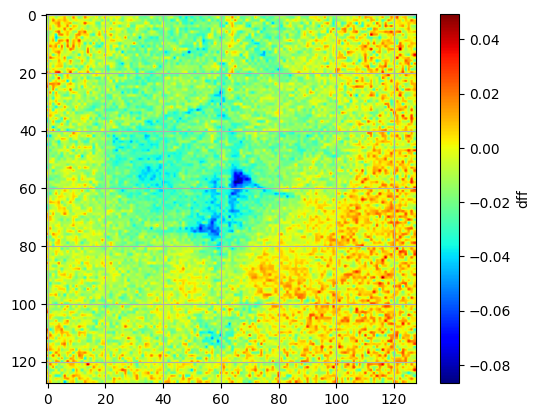

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:41,  3.07it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.24it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.29it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:36,  3.44it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:34,  3.58it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:32,  3.75it/s]

  5%|████▍                                                                             | 7/128 [00:01<00:32,  3.67it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:34,  3.52it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:33,  3.55it/s]

  8%|██████▎                                                                          | 10/128 [00:02<00:32,  3.65it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:32,  3.59it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:32,  3.58it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:32,  3.54it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:34,  3.34it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:35,  3.18it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:39,  2.85it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:40,  2.77it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:40,  2.71it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:40,  2.67it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:39,  2.76it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:39,  2.69it/s]

 17%|█████████████▉                                                                   | 22/128 [00:07<00:39,  2.68it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:38,  2.71it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:40,  2.57it/s]

 20%|███████████████▊                                                                 | 25/128 [00:08<00:39,  2.64it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:38,  2.67it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:36,  2.77it/s]

 22%|█████████████████▋                                                               | 28/128 [00:09<00:35,  2.81it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:33,  2.94it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:32,  2.99it/s]

 24%|███████████████████▌                                                             | 31/128 [00:10<00:32,  3.00it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:32,  3.00it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:31,  3.04it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:11<00:32,  2.94it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:31,  2.96it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:30,  3.05it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:12<00:28,  3.19it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:26,  3.34it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:25,  3.48it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:13<00:27,  3.23it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:26,  3.27it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.24it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:24,  3.43it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:25,  3.33it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:24,  3.44it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:23,  3.56it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:15<00:23,  3.49it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:23,  3.45it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:21,  3.60it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:22,  3.53it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:22,  3.48it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.44it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.35it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:21,  3.44it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:20,  3.49it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:21,  3.31it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.32it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.24it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:20,  3.34it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.22it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:21,  3.17it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.19it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:20,  3.24it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.18it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.27it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.35it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:17,  3.46it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:17,  3.37it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.31it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.30it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:17,  3.31it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:18,  3.11it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:17,  3.06it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:17,  3.04it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:17,  3.12it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:16,  3.08it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:15,  3.25it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:14,  3.40it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:14,  3.36it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:14,  3.27it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:13,  3.43it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.51it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:12,  3.46it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:12,  3.39it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.37it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.41it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.39it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.27it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:11,  3.35it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.43it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:10,  3.41it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.36it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.34it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.36it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.28it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.16it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.17it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.19it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:09,  3.18it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.27it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.28it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.29it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.25it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.17it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:06,  3.33it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.29it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.41it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:05,  3.52it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.50it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.55it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:04,  3.69it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.47it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.48it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.45it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:03,  3.25it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.29it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.44it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:02,  3.59it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.56it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.33it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.19it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.29it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.31it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.35it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.42it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.59it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.74it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.76it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.27it/s]

frame number 200 plotted


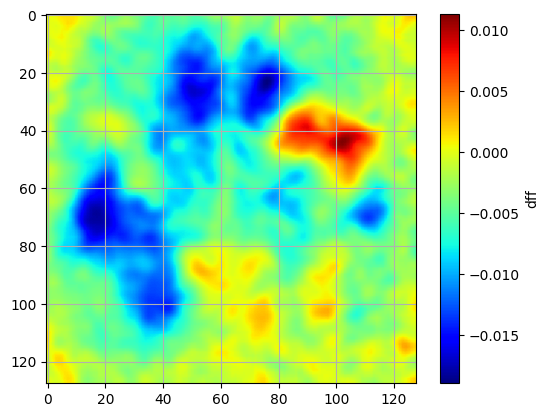

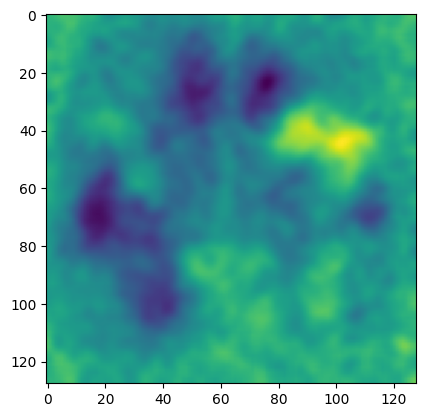

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 19


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 32
fail = 5
total trials = 37


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 39
fail = 5
total trials = 44


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 3
fail = 16
total trials = 19


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34297 [00:00<?, ?it/s]

  7%|█████▌                                                                    | 2570/34297 [00:00<00:01, 25453.82it/s]

 15%|███████████                                                               | 5116/34297 [00:00<00:01, 23532.47it/s]

 23%|████████████████▊                                                         | 7772/34297 [00:00<00:01, 24748.75it/s]

 30%|█████████████████████▊                                                   | 10257/34297 [00:00<00:00, 24602.30it/s]

 37%|███████████████████████████                                              | 12723/34297 [00:00<00:01, 20941.77it/s]

 43%|███████████████████████████████▋                                         | 14893/34297 [00:00<00:00, 20675.67it/s]

 50%|████████████████████████████████████▌                                    | 17155/34297 [00:00<00:00, 21188.36it/s]

 56%|█████████████████████████████████████████▏                               | 19356/34297 [00:00<00:00, 21370.27it/s]

 63%|█████████████████████████████████████████████▊                           | 21520/34297 [00:00<00:00, 20990.75it/s]

 71%|███████████████████████████████████████████████████▌                     | 24252/34297 [00:01<00:00, 22836.58it/s]

 79%|█████████████████████████████████████████████████████████▌               | 27052/34297 [00:01<00:00, 24305.97it/s]

 87%|███████████████████████████████████████████████████████████████▍         | 29815/34297 [00:01<00:00, 25217.68it/s]

 95%|█████████████████████████████████████████████████████████████████████▎   | 32585/34297 [00:01<00:00, 25879.74it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34297/34297 [00:01<00:00, 23638.81it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25003.30it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25010.01it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")